# Wildfire predictions 🔥🌳🛰️🪄

## Predict future wildfires. This novel tool finds past wildfires, crops pre-fire satellite images, and then creates an image dataset of locations that will be burned after the image is taken.

## This dataset is then used to train a neural network. This neural network will try to classify satellite images between "potential future fire location" and "no future fire location".

## The objective is to be ready for the response to disasters, thanks to the fact that the most potentially fire-prone places will be known in advance.

### 1. Install the first time (node, ipyleaflet)

In [1]:
%conda info


     active environment : default
    active env location : /home/studio-lab-user/.conda/envs/default
            shell level : 2
       user config file : /home/studio-lab-user/.condarc
 populated config files : /etc/conda/.condarc
                          /opt/conda/.condarc
          conda version : 4.10.3
    conda-build version : not installed
         python version : 3.9.7.final.0
       virtual packages : __linux=4.14.256=0
                          __glibc=2.31=0
                          __unix=0=0
                          __archspec=1=x86_64
       base environment : /opt/conda  (read only)
      conda av data dir : /opt/conda/etc/conda
  conda av metadata url : None
           channel URLs : https://conda.anaconda.org/conda-forge/linux-64
                          https://conda.anaconda.org/conda-forge/noarch
          package cache : /home/studio-lab-user/.conda/pkgs
                          /opt/conda/pkgs
       envs directories : /home/studio-lab-user/.conda/envs
  

In [2]:
%pip list

Package                       Version
----------------------------- ------------
aenum                         3.1.8
affine                        2.3.0
aiobotocore                   2.1.0
aiohttp                       3.8.1
aioitertools                  0.8.0
aiosignal                     1.2.0
appdirs                       1.4.4
argon2-cffi                   21.1.0
asciitree                     0.3.3
async-generator               1.10
async-timeout                 4.0.2
attrs                         21.2.0
backcall                      0.2.0
backports.functools-lru-cache 1.6.4
bleach                        4.1.0
boto3                         1.20.46
botocore                      1.23.48
bqplot                        0.12.32
branca                        0.4.2
certifi                       2021.10.8
cffi                          1.15.0
cftime                        1.5.2
charset-normalizer            2.0.10
click                         8.0.3
click-plugins                 1.1.1
cligj 

Check if **nodejs** is installed:

In [3]:
!node --version

v17.4.0


Install nodejs if is no installed:

In [8]:
%conda install -c conda-forge nodejs --yes

Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.10.3
  latest version: 4.11.0

Please update conda by running

    $ conda update -n base conda



## Package Plan ##

  environment location: /home/studio-lab-user/.conda/envs/default

  added / updated specs:
    - nodejs


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    nodejs-17.4.0              |       hb5e7134_0        15.3 MB  conda-forge
    ------------------------------------------------------------
                                           Total:        15.3 MB

The following NEW packages will be INSTALLED:

  icu                conda-forge/linux-64::icu-69.1-h9c3ff4c_0
  libuv              conda-forge/linux-64::libuv-1.43.0-h7f98852_0
  nodejs             conda-forge/linux-64::nodejs-17.4.0-hb5e7134_0



nodejs-17.4.0        | 15.3 MB   | ##################################### |

**Restart kernel** in this step.

In [4]:
%pwd

'/home/studio-lab-user'

In [5]:
import sys
print(sys.path)

['/home/studio-lab-user', '/home/studio-lab-user/.conda/envs/default/lib/python39.zip', '/home/studio-lab-user/.conda/envs/default/lib/python3.9', '/home/studio-lab-user/.conda/envs/default/lib/python3.9/lib-dynload', '', '/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages', '/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/IPython/extensions', '/home/studio-lab-user/.ipython']


**IMPORTANT installation step**: 

Open the **terminal (not in jupyter notebook)** and activate the studiolab environment:

**$ conda activate studiolab**

Install the JupyterLab or Jupyter Server extension:

**$ conda install ipyleaflet**

Navigate to the Studio Lab project overview page (https://studiolab.sagemaker.aws/).

Select **Stop runtime**.

Select **Start runtime**.

### 2. Import modules and define constants

In [15]:
import numpy as np
import pandas as pd
import os
import glob
from ipyleaflet import *
from ipywidgets import Label, HTML, DatePicker, Button
from IPython.display import Javascript
import datetime
from sentinelhub import SHConfig, bbox_to_dimensions, WebFeatureService, BBox, CRS, DataCollection, get_area_info, AwsTile, AwsTileRequest
import json

from base64 import b64encode
from PIL import Image, ImageSequence
from io import BytesIO

import rasterio
from rasterio import plot
import matplotlib
import matplotlib.pyplot as plt

import earthpy.spatial as es
import earthpy.plot as ep

In [16]:
DATASET_FOLDER = './dl-fire-datasets'
DATASET_CROPPED_BEFORE_FIRE_FOLDER = './dataset_before_fire/'

M_C61_ARCHIVE = 'fire_archive_M-C61_246193.csv'
M_C61_NRT = 'fire_nrt_M-C61_246193.csv'

BBOX_SPAIN = [-9.494728, 35.418627, 3.290129, 44.133569]
LAT_LON_MADRID = [40.416775, -3.703790]

INITIAL_ZOOM = 6
ZOOM_SEARCH_FOUND = 10

DATE_START = datetime.date(2021,7,1)
DATE_END = datetime.date(2021,7,15)

DATE_START_STR = DATE_START.strftime("%Y-%m-%d")
DATE_END_STR = DATE_END.strftime("%Y-%m-%d")

IS_MARKER_CLUSTER_ACTIVE = True # activate or deactivate the marker clusters

In [34]:
DATE_END_STR

'2021-07-15'

### 3. Load fire dataset and filter

In [602]:
df_orig = pd.read_csv(os.path.join(DATASET_FOLDER, M_C61_ARCHIVE), sep=",", dtype={'acq_time': 'str'})

In [603]:
df_orig

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
0,-11.2690,-27.6022,310.5,1.7,1.3,2021-01-01,0007,Terra,MODIS,71,6.03,294.7,16.4,N,3
1,-6.4528,143.2207,307.0,1.1,1.1,2021-01-01,0101,Terra,MODIS,50,6.03,292.4,5.0,D,0
2,28.7351,9.7986,303.2,1.0,1.0,2021-01-01,0119,Aqua,MODIS,54,6.03,276.0,10.9,N,2
3,28.7368,9.7881,310.7,1.0,1.0,2021-01-01,0119,Aqua,MODIS,81,6.03,276.8,16.1,N,2
4,31.5913,5.9692,302.2,1.2,1.1,2021-01-01,0119,Aqua,MODIS,48,6.03,270.4,14.3,N,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3090808,-32.6069,147.2451,306.6,1.5,1.2,2021-08-31,2357,Terra,MODIS,61,6.03,292.7,10.1,D,0
3090809,-32.1991,146.9268,304.8,1.6,1.2,2021-08-31,2357,Terra,MODIS,53,6.03,294.5,7.4,D,0
3090810,-32.6090,145.7355,304.1,1.8,1.3,2021-08-31,2357,Terra,MODIS,36,6.03,294.0,7.7,D,0
3090811,-32.1986,146.9203,312.9,1.6,1.2,2021-08-31,2357,Terra,MODIS,71,6.03,294.7,17.1,D,0


In [604]:
df_orig.dtypes

latitude      float64
longitude     float64
brightness    float64
scan          float64
track         float64
acq_date       object
acq_time       object
satellite      object
instrument     object
confidence      int64
version       float64
bright_t31    float64
frp           float64
daynight       object
type            int64
dtype: object

In [605]:
df_spain = df_orig[(df_orig.longitude > BBOX_SPAIN[0]) & (df_orig.longitude < BBOX_SPAIN[2]) & (df_orig.latitude > BBOX_SPAIN[1]) & (df_orig.latitude < BBOX_SPAIN[3])]
df_spain

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
3875,35.8061,-0.2536,310.2,3.9,1.8,2021-01-01,1359,Aqua,MODIS,0,6.03,282.0,92.3,D,2
3876,35.7996,-0.2451,311.3,3.9,1.8,2021-01-01,1359,Aqua,MODIS,34,6.03,280.1,98.3,D,2
4634,37.9583,-8.7866,301.0,2.5,1.5,2021-01-02,0200,Aqua,MODIS,36,6.03,276.8,33.1,N,0
7322,37.0886,-5.8802,300.4,1.1,1.0,2021-01-02,1125,Terra,MODIS,37,6.03,287.8,5.1,D,0
7323,38.0170,-7.5735,300.0,1.0,1.0,2021-01-02,1125,Terra,MODIS,21,6.03,283.0,6.1,D,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3069453,42.8734,-5.5579,302.3,1.1,1.0,2021-08-30,2227,Terra,MODIS,48,6.03,284.5,7.5,N,0
3069454,42.8750,-5.5446,327.0,1.1,1.0,2021-08-30,2227,Terra,MODIS,100,6.03,286.6,30.7,N,0
3069455,43.0303,-5.6210,342.0,1.1,1.0,2021-08-30,2227,Terra,MODIS,100,6.03,284.5,54.9,N,0
3069456,43.0319,-5.6081,339.4,1.1,1.0,2021-08-30,2227,Terra,MODIS,100,6.03,284.5,50.1,N,0


In [606]:
df_spain = df_spain[df_spain['confidence'] > 70]
df_spain

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
10001,36.8745,-2.4347,334.7,1.2,1.1,2021-01-02,2228,Terra,MODIS,100,6.03,279.1,53.3,N,2
18725,40.2352,-0.8699,320.1,1.1,1.1,2021-01-04,1112,Terra,MODIS,80,6.03,276.0,26.4,D,0
24047,43.5413,-5.8322,317.1,1.0,1.0,2021-01-04,2218,Terra,MODIS,94,6.03,271.8,21.0,N,2
55101,40.9385,-8.0189,317.4,1.2,1.1,2021-01-07,1323,Aqua,MODIS,78,6.03,279.9,25.7,D,0
55102,41.6448,-3.8641,315.8,1.0,1.0,2021-01-07,1324,Aqua,MODIS,76,6.03,276.7,18.1,D,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3069451,42.0482,-7.8604,309.5,1.0,1.0,2021-08-30,2227,Terra,MODIS,78,6.03,285.2,11.5,N,0
3069454,42.8750,-5.5446,327.0,1.1,1.0,2021-08-30,2227,Terra,MODIS,100,6.03,286.6,30.7,N,0
3069455,43.0303,-5.6210,342.0,1.1,1.0,2021-08-30,2227,Terra,MODIS,100,6.03,284.5,54.9,N,0
3069456,43.0319,-5.6081,339.4,1.1,1.0,2021-08-30,2227,Terra,MODIS,100,6.03,284.5,50.1,N,0


In [607]:
# Date range filter
df_spain_date_filtered = df_spain[(df_spain['acq_date'] >= DATE_START_STR) & (df_spain['acq_date'] <= DATE_END_STR)]
df_spain_date_filtered

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
1702958,35.9118,1.2323,337.2,1.9,1.3,2021-07-01,1239,Aqua,MODIS,77,6.03,314.3,44.9,D,0
1706184,35.8067,-0.2533,319.6,1.0,1.0,2021-07-01,2201,Terra,MODIS,99,6.03,294.9,16.3,N,2
1721288,39.3638,-3.8653,334.0,2.1,1.4,2021-07-02,1141,Terra,MODIS,77,6.03,313.8,55.3,D,0
1724841,35.6441,-0.7811,345.8,1.1,1.0,2021-07-02,1322,Aqua,MODIS,87,6.03,315.6,37.0,D,0
1724842,35.6426,-0.7928,337.0,1.1,1.0,2021-07-02,1322,Aqua,MODIS,74,6.03,314.6,21.1,D,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1970866,41.1895,-7.8678,323.4,3.7,1.8,2021-07-15,0325,Aqua,MODIS,100,6.03,287.2,152.3,N,0
1970867,41.1954,-7.8570,319.8,3.7,1.8,2021-07-15,0325,Aqua,MODIS,99,6.03,286.8,129.6,N,0
1982989,42.1290,-4.4215,322.9,1.9,1.3,2021-07-15,1253,Aqua,MODIS,73,6.03,306.0,24.4,D,0
1987646,41.6589,-8.5126,313.8,1.3,1.1,2021-07-15,2215,Terra,MODIS,88,6.03,294.6,16.8,N,0


### 4. Configure map and filters

In [782]:
m = Map(center=LAT_LON_MADRID, zoom=INITIAL_ZOOM, basemap=basemaps.CartoDB.Voyager, layout=dict(height="700px"))

# fullscreen button
control = FullScreenControl()
m.add_control(control)

# distance
measure = MeasureControl(
    position="bottomleft", active_color="orange", primary_length_unit="kilometers"
)
m.add_control(measure)

# Search using url.
search = SearchControl(
    position="topleft",
    url="https://nominatim.openstreetmap.org/search?format=json&q={s}",
    zoom=ZOOM_SEARCH_FOUND,
    property_name="display_name",
    # marker=marker,
)
m.add_control(search)

# scale legend in km
scale = ScaleControl(position="bottomleft", imperial=False)
m.add_control(scale)

# label for lat/lon mouse position
labelLatLon = Label()
labelTotalFiresShow = Label()

def handle_interaction(**kwargs):
    if kwargs.get("type") == "mousemove":
        labelLatLon.value = 'Mouse position (lat/Lon): ' + str(kwargs.get("coordinates"))


m.on_interaction(handle_interaction)

In [783]:
# Add markers
markers = []

the_markers_container = {}

if IS_MARKER_CLUSTER_ACTIVE == True:

    the_markers_container = MarkerCluster(
        markers=markers,
        disable_clustering_at_zoom=6,
        max_cluster_radius=50,
        show_coverage_on_hover=True,
        zoom_to_bounds_on_click=True,
        spiderfy_on_max_zoom=True
    )
    the_markers_container.name = "THE FIRES (clusters active)"

else:
    the_markers_container = LayerGroup(layers=(markers), name='THE FIRES')

m.add_layer(the_markers_container)

m.add_control(LayersControl())

In [784]:
def get_color(row):
    """
    Types of fires:
    0 = presumed vegetation fire
    1 = active volcano
    2 = other static land source
    3 = offshore detection (includes all detections over water)
    
    Supported colors:
    ['white', 'red', 'darkred', 'lightred', 'orange', 'beige', 'green', 
    'darkgreen', 'lightgreen', 'blue', 'darkblue', 'lightblue', 'purple',
    'darkpurple', 'pink', 'cadetblue', 'white', 'gray', 'lightgray', 'black']
    """
    if 'type' not in row:
        return 'black'
    
    v = row['type']
    if v==0:
        return 'green'
    elif v==1:
        return 'orange'
    elif v==2:
        return 'gray'
    elif v==3:
        return 'blue'
    else:
        return 'black'

def get_type_name(row):
    if 'type' not in row:
        return 'fire type not available'
    
    v = row['type']
    if v==0:
        return 'presumed vegetation fire'
    elif v==1:
        return 'active volcano'
    elif v==2:
        return 'other static land source'
    elif v==3:
        return 'offshore detection (includes all detections over water)'
    else:
        return 'unknown fire type'

# latitude	longitude	brightness	scan	track	acq_date	acq_time...
# ...satellite	instrument	confidence	version	bright_t31	frp	daynight
def create_popup_marker(row, index):
    html_widget = HTML(
        value="""
            <div>
            <b>{t}</b><br/>
            Lat/Lon: {lat}, {lon}<br/>
            acq_date: {acq_date}<br/>
            acq_time: {acq_time} (hh:mm UTC)<br/>
            confidence: {confidence} %<br/>
            FRP: {frp}<br/>
            index: {index}
            </div>
            """.format(t=get_type_name(row), lat=row.latitude, lon=row.longitude, acq_date=row.acq_date,
                             acq_time=row.acq_time, confidence=row.confidence, frp=row.frp, index=index),
        placeholder="",
        description="",
    )
    return html_widget

In [785]:
def update_date_filter_and_markers(df_full, date_from, date_to):
    df_filtered = df_full[(df_full['acq_date'] >= date_from) & (df_full['acq_date'] <= date_to)]
    
    markers = []
    
    for index, row in df_filtered.iterrows(): 
        icon = AwesomeIcon(name='fire', marker_color=get_color(row))
        marker_aux = Marker(icon=icon, location=(row['latitude'], row['longitude']))
        marker_aux.popup = create_popup_marker(row, index)
        markers.append(marker_aux)
    return df_filtered, markers

In [786]:
df_spain_date_filtered, markers = update_date_filter_and_markers(df_spain, DATE_START_STR, DATE_END_STR)

In [787]:
len(markers)

86

In [788]:
if IS_MARKER_CLUSTER_ACTIVE == True:
    the_markers_container.markers = markers
else:
    the_markers_container.layers = markers

In [789]:
# legend
a_legend = LegendControl(
    {
        "🌳 Presumed vegetation fire": "green",
        "🌋 Active volcano": "orange",
        "🏢 Other static land source": "gray",
        "🌊 Offshore detection (includes all detections over water)": "blue",
        "❓ Unknown type": 'black'
    },
    name="Legend",
    position="bottomright",
)

m.add_control(a_legend)

In [790]:
def map_bounds_changed(event):
    # TODO: I can filter by bound when bound changed
    print('map_bounds_changed')
    # print(str(event))

In [791]:
fromDate = DatePicker(
    description='From',
    disabled=False
)
fromDate.value= DATE_START

toDate = DatePicker(
    description='To',
    disabled=False
)
toDate.value= DATE_END

btnFilter = Button(
    description=' Filter ',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltip='Click me',
    icon='filter' # (FontAwesome names without the `fa-` prefix)
)


controlFrom = WidgetControl(widget=fromDate, position="topright")
m.add_control(controlFrom)

controlTo = WidgetControl(widget=toDate, position="topright")
m.add_control(controlTo)

controlButton = WidgetControl(widget=btnFilter, position="topright")
m.add_control(controlButton)

m.observe(map_bounds_changed, 'bounds')

In [792]:
def date_filter_handler(button):
    m.default_style = {"cursor": "wait"}
    btnFilter.description = 'Filtering...'
    
    from_date_str = fromDate.value.strftime("%Y-%m-%d")
    to_date_str = toDate.value.strftime("%Y-%m-%d")
    
    df_spain_date_filtered, markers = update_date_filter_and_markers(df_spain, from_date_str, to_date_str)
    

    if IS_MARKER_CLUSTER_ACTIVE == True:
        the_markers_container.markers = markers
    else:
        the_markers_container.layers = markers
    
    
    labelTotalFiresShow.value = str(len(markers)) + ' fires shown'
    
    m.default_style = {"cursor": "default"}
    
    btnFilter.description = 'Filtered (' + str(len(markers)) + ' fires)'

In [793]:
btnFilter.on_click(date_filter_handler)

### 5. Show the map

In [794]:
display(m)
display(labelLatLon)
display(labelTotalFiresShow)

Map(center=[40.416775, -3.70379], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', …

Label(value='')

Label(value='')

### 6. Download satellite images from before the fire started and after the fire started.

In [795]:
selected_row = df_orig.iloc[1987646] # 1843754] # select one fire by index row.

In [796]:
"""
index: 1843754
presumed vegetation fire
Lat/Lon: 39.7322, -5.436
acq_date: 2021-07-08
acq_time: 12:46 (hh:mm UTC)
confidence: 100 %
FRP: 1022.3
"""

def get_search_time_interval_and_lat_lon(r):
    lat_lon = [r['latitude'], r['longitude']]
    fire_selected_date_str = r['acq_date'] # fire date
    split_date = fire_selected_date_str.split('-')

    fire_selected_date = datetime.date(int(split_date[0]),int(split_date[1]),int(split_date[2]))
    print(fire_selected_date)

    datetime_from = fire_selected_date - datetime.timedelta(days=15) # -15 days before fire.
    datetime_from_str = datetime_from.strftime("%Y-%m-%d") + 'T00:00:00'

    datetime_to = fire_selected_date + datetime.timedelta(days=5) # +5 days after fire begun.
    datetime_to_str = datetime_to.strftime("%Y-%m-%d") + 'T00:00:00'

    search_time_interval = (datetime_from_str, datetime_to_str)
    return search_time_interval, lat_lon

In [797]:
search_time_interval, lat_lon = get_search_time_interval_and_lat_lon(selected_row)
search_time_interval

2021-07-15


('2021-06-30T00:00:00', '2021-07-20T00:00:00')

In [798]:
config = SHConfig()

with open("config.json") as json_data_file:
    cfg = json.load(json_data_file)

config.instance_id = cfg["sentinelhub"]["instance_id"]
config.aws_access_key_id = cfg["aws"]["access_key_id"]
config.aws_secret_access_key = cfg["aws"]["secret_access_key"]

# Save the configuration
config.save()

In [799]:
def get_search_bbox(lat_lon):
    offset = 0.0044991155958
    x = lat_lon[1]
    y = lat_lon[0]
    one_fire_box = [x-offset, y-offset, x+offset, y+offset]
    # print(one_fire_box)

    search_bbox = BBox(bbox=one_fire_box, crs=CRS.WGS84)
    return search_bbox

In [800]:
search_bbox = get_search_bbox(lat_lon)
search_bbox

BBox(((-8.517099115595801, 41.654400884404204), (-8.5081008844042, 41.6633991155958)), crs=CRS('4326'))

In [801]:
def get_data_before_and_after_one_fire(search_bbox, search_time_interval):
    results = get_area_info(search_bbox, search_time_interval, maxcc=0.5)
    print(str(len(results)) + ' satellite moments in the interval:\n')

    tile_id_before_fire = ''
    tile_id_after_fire = ''

    tile_name= ''

    bound_tile = []

    for tile_info in results: # maxcc in range [0, 1] – filter imgs by max % of clouds.
        if 'VGS2' not in tile_id_after_fire:
            tile_id_after_fire = tile_info['properties']['title'] 
            tile_name = tile_id_after_fire.split('_')[-2]
            bound_tile = tile_info['geometry']['coordinates'][0][0]
        elif 'VGS2' in tile_info['properties']['title']:
            if tile_name in tile_info['properties']['title']:
                tile_id_before_fire = tile_info['properties']['title'] 

        suffix = ''
        title = tile_info['properties']['title']

        print(title + suffix)
        print('  ' + str(tile_info['geometry']['coordinates']))
    
    return tile_id_before_fire, tile_id_after_fire, bound_tile

In [802]:
tile_id_before_fire, tile_id_after_fire, bound_tile = get_data_before_and_after_one_fire(search_bbox, search_time_interval)

6 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS4_20210718T121443_A022800_T29TNG_N03.01
  [[[[-8.8423471015163, 42.45257377694], [-9.0002292584089, 41.955024562881], [-9.0002275196194, 41.463760893976], [-7.6855936689808, 41.4562510388], [-7.6651207807638, 42.444908861831], [-8.8423471015163, 42.45257377694]]]]
S2A_OPER_MSI_L1C_TL_VGS2_20210716T134648_A031680_T29TNG_N03.01
  [[[[-9.0002310646851, 42.452682192651], [-9.0002275196194, 41.463760893976], [-8.0289670073484, 41.459662384459], [-7.8835149624185, 41.856765788792], [-7.6810608452733, 42.389965447631], [-7.6671786674308, 42.42229648066], [-7.6663366605707, 42.444923017239], [-9.0002310646851, 42.452682192651]]]]
S2A_OPER_MSI_L1C_TL_VGS2_20210713T133315_A031637_T29TNG_N03.01
  [[[[-8.8352936452366, 42.452563858763], [-9.0002291771032, 41.932324189439], [-9.0002275196194, 41.463760893976], [-7.6855936689808, 41.4562510388], [-7.6651207807638, 42.444908861831], [-8.8352936452366, 42.452563858763]]]]
S2B_OPER_MSI_L1C_TL

In [803]:
print(tile_id_before_fire) # = results[0]['properties']['title']
print(tile_id_after_fire) # = results[-1]['properties']['title']

S2A_OPER_MSI_L1C_TL_VGS2_20210713T133315_A031637_T29TNG_N03.01
S2A_OPER_MSI_L1C_TL_VGS2_20210716T134648_A031680_T29TNG_N03.01


In [804]:
bound_tile

[[-9.0002310646851, 42.452682192651],
 [-9.0002275196194, 41.463760893976],
 [-8.0289670073484, 41.459662384459],
 [-7.8835149624185, 41.856765788792],
 [-7.6810608452733, 42.389965447631],
 [-7.6671786674308, 42.42229648066],
 [-7.6663366605707, 42.444923017239],
 [-9.0002310646851, 42.452682192651]]

In [805]:
# manual version:
# tile_id_before_fire = 'S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T29TQE_N03.01'
# tile_id_after_fire = 'S2A_OPER_MSI_L1C_TL_VGS2_20210710T132405_A031594_T29TQE_N03.01'

In [806]:
tile_name_before, time_before, aws_index_before = AwsTile.tile_id_to_tile(tile_id_before_fire)
tile_name_after, time_after, aws_index_after = AwsTile.tile_id_to_tile(tile_id_after_fire)
tile_name_after, time_after, aws_index_after

('29TNG', '2021-7-16', 0)

In [830]:
def request_tiles(tile_name_before, time_before, aws_index_before, tile_name_after, time_after, aws_index_after):
    bands = ['B02'] # , 'B03', 'B04', 'B08']
    metafiles = ['metadata', 'tileInfo', 'preview', 'qi/MSK_CLOUDS_B00'] # ['metadata', 'tileInfo', 'preview/B01', 'TCI']
    data_folder = './AwsData'
    
    request = AwsTileRequest(
        tile=tile_name_before,
        time=time_before,
        aws_index=aws_index_before,
        bands=bands,
        metafiles=metafiles,
        data_folder=data_folder,
        data_collection=DataCollection.SENTINEL2_L1C
    )

    request.save_data()
    
    FOLDER_BEFORE = './AwsData/{}/'.format(request.get_filename_list()[0].split('/')[0])
    print('FOLDER_BEFORE: ' + FOLDER_BEFORE)
    
    request = AwsTileRequest(
        tile=tile_name_after,
        time=time_after,
        aws_index=aws_index_after,
        bands=bands,
        metafiles=metafiles,
        data_folder=data_folder,
        data_collection=DataCollection.SENTINEL2_L1C
    )

    request.save_data()
    
    FOLDER_AFTER = './AwsData/{}/'.format(request.get_filename_list()[0].split('/')[0])
    print('FOLDER_AFTER: ' + FOLDER_AFTER)
    
    return FOLDER_BEFORE, FOLDER_AFTER

In [808]:
FOLDER_BEFORE, FOLDER_AFTER = request_tiles(tile_name_before, time_before, aws_index_before, tile_name_after, time_after, aws_index_after)

FOLDER_BEFORE: ./AwsData/29TNG,2021-07-13,0/
FOLDER_AFTER: ./AwsData/29TNG,2021-07-16,0/


### 7. Calculate fire rectangle perimeter (in order tu crop images)

In [809]:
def swap_lat_lon(v):
    bound_tile_new = []
    for one in v:
        bound_tile_new.append([one[1], one[0]])
    return bound_tile_new

In [810]:
fire_small_perimeter = swap_lat_lon(search_bbox.get_polygon())
fire_small_perimeter

[[41.654400884404204, -8.517099115595801],
 [41.6633991155958, -8.517099115595801],
 [41.6633991155958, -8.5081008844042],
 [41.654400884404204, -8.5081008844042],
 [41.654400884404204, -8.517099115595801]]

In [811]:
# bound_tile = results[-1]['geometry']['coordinates'][0][0]
"""
[[-6.5454514550479, 40.596392838306], 
              [-6.4945014949822, 39.609022489798], 
              [-5.2167765905168, 39.640457343317], 
              [-5.2491462940419, 40.628939760926], 
              [-6.5454514550479, 40.596392838306]]
"""
bound_tile = swap_lat_lon(bound_tile)

### 8. Overlay image previews in map (image before fire and image after fire)

In [812]:
pl = Polyline(locations=bound_tile, name='Tile perimeter')
m.add_layer(pl)
print(bound_tile)

[[42.452682192651, -9.0002310646851], [41.463760893976, -9.0002275196194], [41.459662384459, -8.0289670073484], [41.856765788792, -7.8835149624185], [42.389965447631, -7.6810608452733], [42.42229648066, -7.6671786674308], [42.444923017239, -7.6663366605707], [42.452682192651, -9.0002310646851]]


In [813]:
pl_fire = Polyline(locations=fire_small_perimeter, color='red', fill_opacity=0, name='Fire small perimeter')
m.add_layer(pl_fire)

In [814]:
# m.remove_layer(pl_fire)

In [815]:
def image_overlay(map, url, bounds, name):
        """Overlays an image from the Internet or locally on the map.

        Args:
            url (str): http URL or local file path to the image.
            bounds (tuple): bounding box of the image in the format of (lower_left(lat, lon), upper_right(lat, lon)), such as ((13, -130), (32, -100)).
            name (str): name of the layer to show on the layer control.
        """
        try:
            if not url.startswith('http'):
                ext = os.path.splitext(url)[1][1:] # file extension
                image = Image.open(url)

                f = BytesIO()
                if ext.lower() == 'gif':
                    frames = []
                    # Loop over each frame in the animated image
                    for frame in ImageSequence.Iterator(image):
                        frame = frame.convert('RGBA')
                        b = BytesIO()
                        frame.save(b, format="gif")
                        frame = Image.open(b)
                        frames.append(frame)
                    frames[0].save(f, format='GIF', save_all=True, append_images=frames[1:], loop=0)
                else:                 
                    image.save(f, 'png') # ext)

                data = b64encode(f.getvalue())
                data = data.decode('ascii')
                url = 'data:image/{};base64,'.format(ext) + data
            img = ImageOverlay(url=url, bounds=bounds, name=name)
            map.add_layer(img)
            return img
        except Exception as e:
            print(e)
            return

In [816]:
aux_layer_before = image_overlay(m, FOLDER_BEFORE + 'preview.jpg', bound_tile[:-1], 'image before fire')
aux_layer_after = image_overlay(m, FOLDER_AFTER + 'preview.jpg', bound_tile[:-1], 'image after fire')

Done! look at the map and activate deactivate the layers with the images 🖼️ of before and after the fire.

In [817]:
# m.remove_layer(aux_layer_before)
# m.remove_layer(aux_layer_after)

### 9. Crop the images to show only the fire area.

In [818]:
def show_image_before_and_after(FOLDER_BEFORE, FOLDER_AFTER, time_before, time_after, filename):
    src = rasterio.open(FOLDER_BEFORE + filename)
    plt.figure(figsize=(8,8))
    plt.title('Before fire ({})'.format(time_before))
    plot.show(src)

    src = rasterio.open(FOLDER_AFTER + filename)
    plt.figure(figsize=(8,8))
    plt.title('After fire ({})'.format(time_after))
    plot.show(src)

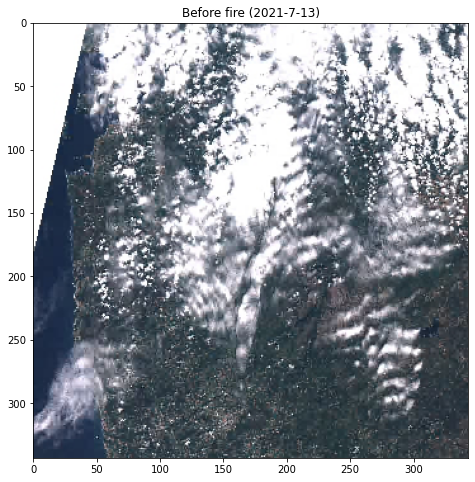

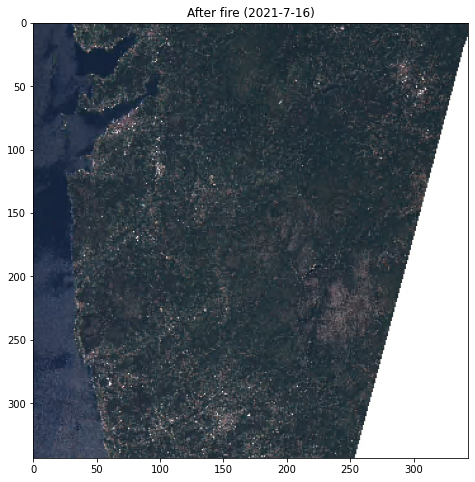

In [819]:
show_image_before_and_after(FOLDER_BEFORE, FOLDER_AFTER, time_before, time_after, 'preview.jpg')

In [820]:
def get_bounds(polygon):
    min_lat = 180
    min_lon = 180
    max_lat = -180
    max_lon = -180
    for one in polygon:
        if one[0] < min_lat:
            min_lat = one[0]
        if one[1] < min_lon:
            min_lon = one[1]
        if one[0] > max_lat:
            max_lat = one[0]
        if one[1] > max_lon:
            max_lon = one[1]
            
    return [[min_lat, min_lon], [max_lat, max_lon]]
    

def crop_image_geo(img_path, img_path_dest, bounds_image, bounds_crop, show_image_orig, show_image_cropped):
    # it's not 100% accurate because it doesn't take projection into account, but it's good enough.
    
    # print('bounds_image: ', bounds_image)
    # print('bounds_crop:', bounds_crop)
    
    # Opens a image in RGB mode
    im = Image.open(img_path)

    w, h = im.size
    # print('width: ', w)
    # print('height:', h)
    
    bound_img = get_bounds(bounds_image)
    print(bound_img)
    
    bound_crop = get_bounds(bounds_crop)
    
    crop_top = (bound_img[1][0] - bound_crop[1][0]) * h / (bound_img[1][0] - bound_img[0][0])
    # print(crop_top)
    
    crop_bottom = (bound_crop[0][0] - bound_img[0][0]) * h / (bound_img[1][0] - bound_img[0][0])
    # print(crop_bottom)
       
    crop_left = (bound_crop[0][1] - bound_img[0][1]) * w / (bound_img[1][1] - bound_img[0][1])
    # print(crop_left)
    
    crop_right = (bound_img[1][1] - bound_crop[1][1]) * w / (bound_img[1][1] - bound_img[0][1])
    # print(crop_right)

    # Setting the points for cropped image
    left = crop_left
    top = crop_top
    right = w - crop_right
    bottom = h - crop_bottom

    # Cropped image of above dimension
    # (It will not change original image)
    im1 = im.crop((left, top, right, bottom))

    if show_image_orig:
        im.show()
    
    print(bound_crop)
    
    # Shows the image in image viewer
    if show_image_cropped:
        im1.show()
    
    im1.save(img_path_dest + '.crop.png',"PNG")
    
    w, h = im1.size
    print('width: ', w)
    print('height:', h)

[[41.459662384459, -9.0002310646851], [42.452682192651, -7.6663366605707]]


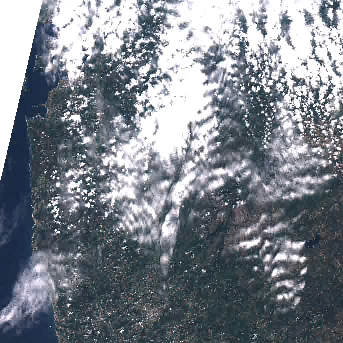

[[41.654400884404204, -8.517099115595801], [41.6633991155958, -8.5081008844042]]


width:  3
height: 3


In [821]:
crop_image_geo(FOLDER_BEFORE + 'preview.jpg', DATASET_CROPPED_BEFORE_FIRE_FOLDER + FOLDER_BEFORE.split('/')[-2] + '.preview.jpg', bound_tile[:-1], fire_small_perimeter[:-1], True, True)

In [822]:
crop_image_geo(FOLDER_BEFORE + 'B02.jp2', DATASET_CROPPED_BEFORE_FIRE_FOLDER + FOLDER_BEFORE.split('/')[-2] + '.B02.jp2', bound_tile[:-1], fire_small_perimeter[:-1], False, False)

[[41.459662384459, -9.0002310646851], [42.452682192651, -7.6663366605707]]
[[41.654400884404204, -8.517099115595801], [41.6633991155958, -8.5081008844042]]
width:  74
height: 100


In [823]:
crop_image_geo(FOLDER_AFTER + 'B02.jp2', FOLDER_AFTER + 'B02.jp2', bound_tile[:-1], fire_small_perimeter[:-1], False, False)

[[41.459662384459, -9.0002310646851], [42.452682192651, -7.6663366605707]]
[[41.654400884404204, -8.517099115595801], [41.6633991155958, -8.5081008844042]]
width:  74
height: 100


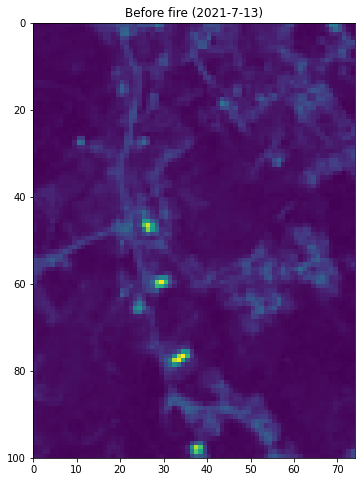

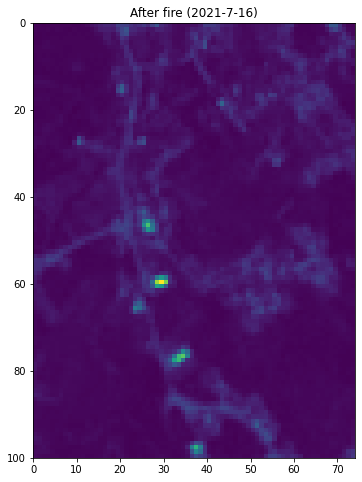

In [827]:
show_image_before_and_after(DATASET_CROPPED_BEFORE_FIRE_FOLDER + FOLDER_BEFORE.split('/')[-2] + '.', FOLDER_AFTER, time_before, time_after, 'B02.jp2.crop.png')

### 10. Repeat for all wildforests, in order to create cropped images before fire dataset

In [742]:
df_for_dataset = df_spain_date_filtered[df_spain_date_filtered['type'] == 0]
df_for_dataset

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
1702958,35.9118,1.2323,337.2,1.9,1.3,2021-07-01,1239,Aqua,MODIS,77,6.03,314.3,44.9,D,0
1721288,39.3638,-3.8653,334.0,2.1,1.4,2021-07-02,1141,Terra,MODIS,77,6.03,313.8,55.3,D,0
1724841,35.6441,-0.7811,345.8,1.1,1.0,2021-07-02,1322,Aqua,MODIS,87,6.03,315.6,37.0,D,0
1724842,35.6426,-0.7928,337.0,1.1,1.0,2021-07-02,1322,Aqua,MODIS,74,6.03,314.6,21.1,D,0
1724844,37.6506,-8.5008,345.3,1.5,1.2,2021-07-02,1323,Aqua,MODIS,89,6.03,308.6,74.2,D,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1970866,41.1895,-7.8678,323.4,3.7,1.8,2021-07-15,0325,Aqua,MODIS,100,6.03,287.2,152.3,N,0
1970867,41.1954,-7.8570,319.8,3.7,1.8,2021-07-15,0325,Aqua,MODIS,99,6.03,286.8,129.6,N,0
1982989,42.1290,-4.4215,322.9,1.9,1.3,2021-07-15,1253,Aqua,MODIS,73,6.03,306.0,24.4,D,0
1987646,41.6589,-8.5126,313.8,1.3,1.1,2021-07-15,2215,Terra,MODIS,88,6.03,294.6,16.8,N,0


selected_row: latitude         35.9118
longitude         1.2323
brightness         337.2
scan                 1.9
track                1.3
acq_date      2021-07-01
acq_time            1239
satellite           Aqua
instrument         MODIS
confidence            77
version             6.03
bright_t31         314.3
frp                 44.9
daynight               D
type                   0
Name: 1702958, dtype: object
2021-07-01
search_bbox: 1.2278008844041999,35.9073008844042,1.2367991155958,35.9162991155958
3 satellite moments in the interval:

S2A_OPER_MSI_L1C_TL_VGS2_20210701T124711_A031465_T31SCV_N03.01
  [[[[0.7776148911953, 36.124267207564], [0.80484069416807, 35.135011160465], [2.0097096778922, 35.150851996093], [1.9974176909957, 36.140692888429], [0.7776148911953, 36.124267207564]]]]
S2A_OPER_MSI_L1C_TL_VGS2_20210621T142009_A031322_T31SCV_N03.00
  [[[[0.7776148911953, 36.124267207564], [0.80484069416807, 35.135011160465], [2.0097096778922, 35.150851996093], [1.9974176909957, 36.14

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/31SCV,2021-06-16,1/


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/31SCV,2021-07-01,0/
fire_small_perimeter: [[35.9073008844042, 1.2278008844041999], [35.9162991155958, 1.2278008844041999], [35.9162991155958, 1.2367991155958], [35.9073008844042, 1.2367991155958], [35.9073008844042, 1.2278008844041999]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


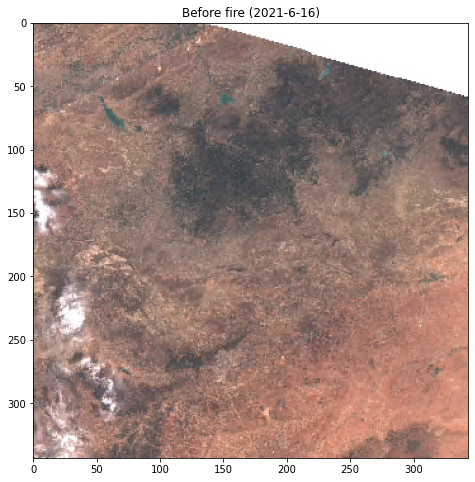

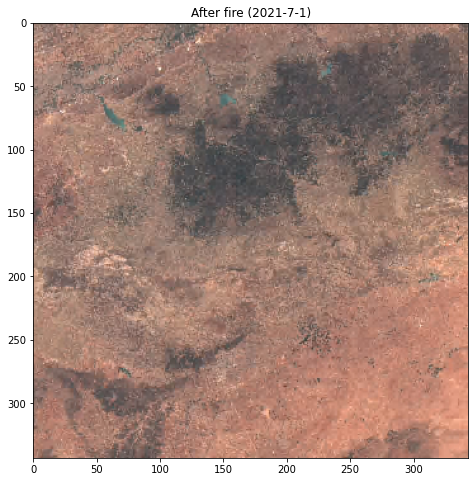

[[35.135011160465, 0.7776148911953], [36.140692888429, 2.0097096778922]]


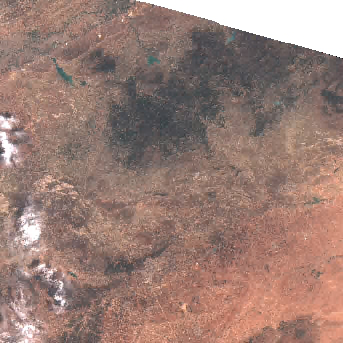

[[35.9073008844042, 1.2278008844041999], [35.9162991155958, 1.2367991155958]]


width:  3
height: 3
[[35.135011160465, 0.7776148911953], [36.140692888429, 2.0097096778922]]
[[35.9073008844042, 1.2278008844041999], [35.9162991155958, 1.2367991155958]]
width:  80
height: 98
[[35.135011160465, 0.7776148911953], [36.140692888429, 2.0097096778922]]
[[35.9073008844042, 1.2278008844041999], [35.9162991155958, 1.2367991155958]]
width:  80
height: 98


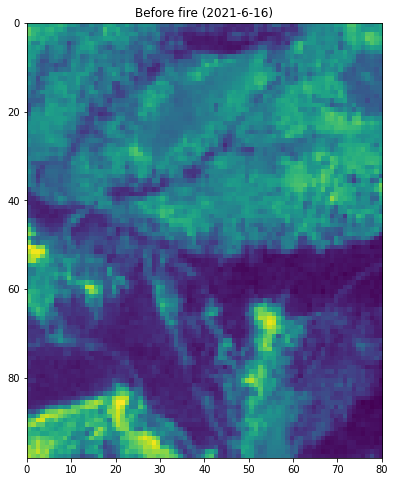

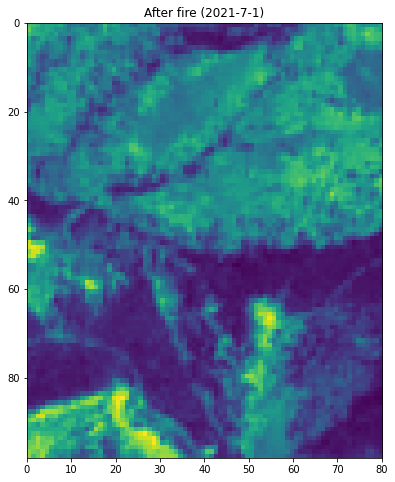

selected_row: latitude         39.3638
longitude        -3.8653
brightness         334.0
scan                 2.1
track                1.4
acq_date      2021-07-02
acq_time            1141
satellite          Terra
instrument         MODIS
confidence            77
version             6.03
bright_t31         313.8
frp                 55.3
daynight               D
type                   0
Name: 1721288, dtype: object
2021-07-02
search_bbox: -3.8697991155958,39.3593008844042,-3.8608008844042,39.368299115595796
6 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T30SVJ_N03.01
  [[[[-4.1676129061651, 39.744386309942], [-4.1513211203196, 38.755202927617], [-3.9639359251734, 38.756898608041], [-3.6172971017433, 39.748617549456], [-4.1676129061651, 39.744386309942]]]]
S2B_OPER_MSI_L1C_TL_VGS4_20210702T121603_A022571_T30SVJ_N03.01
  [[[[-4.1676129061651, 39.744386309942], [-4.1513211203196, 38.755202927617], [-2.88767593357, 38.760819497476], [-2.8860860573707,

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/30SVJ,2021-06-17,0/


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/30SVJ,2021-07-05,0/
fire_small_perimeter: [[39.3593008844042, -3.8697991155958], [39.368299115595796, -3.8697991155958], [39.368299115595796, -3.8608008844042], [39.3593008844042, -3.8608008844042], [39.3593008844042, -3.8697991155958]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


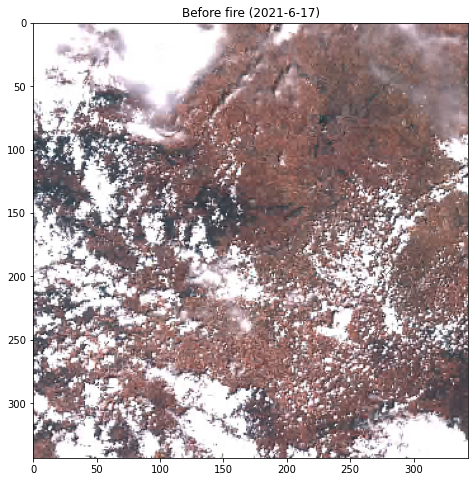

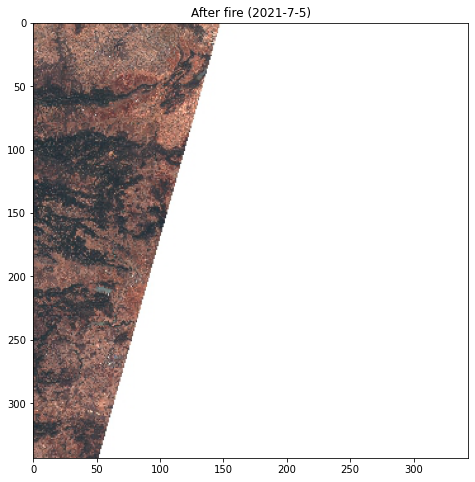

[[38.755202927617, -4.1676129061651], [39.748617549456, -3.6172971017433]]


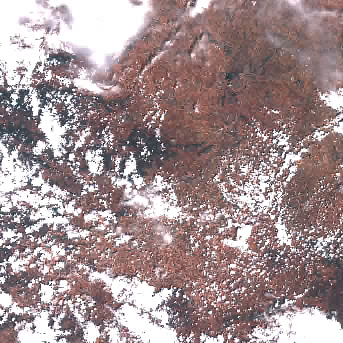

[[39.3593008844042, -3.8697991155958], [39.368299115595796, -3.8608008844042]]


width:  5
height: 3
[[38.755202927617, -4.1676129061651], [39.748617549456, -3.6172971017433]]
[[39.3593008844042, -3.8697991155958], [39.368299115595796, -3.8608008844042]]
width:  180
height: 99
[[38.755202927617, -4.1676129061651], [39.748617549456, -3.6172971017433]]
[[39.3593008844042, -3.8697991155958], [39.368299115595796, -3.8608008844042]]
width:  180
height: 99


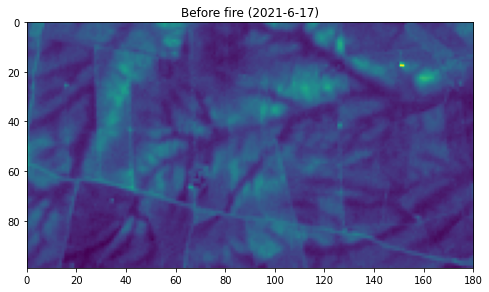

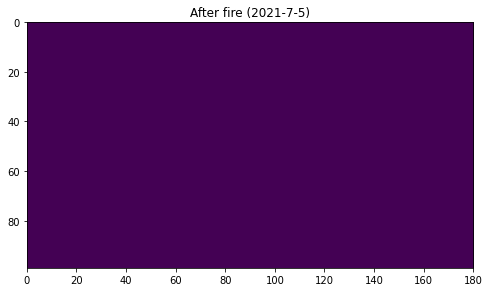

selected_row: latitude         35.6441
longitude        -0.7811
brightness         345.8
scan                 1.1
track                1.0
acq_date      2021-07-02
acq_time            1322
satellite           Aqua
instrument         MODIS
confidence            87
version             6.03
bright_t31         315.6
frp                 37.0
daynight               D
type                   0
Name: 1724841, dtype: object
2021-07-02
search_bbox: -0.7855991155958,35.6396008844042,-0.7766008844042,35.6485991155958
10 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS2_20210706T124446_A022628_T30SXE_N03.01
  [[[[-0.67032866903553, 36.07034215404], [-0.92677268966951, 35.137159415944], [-0.69735281052744, 35.133015549128], [-0.67032866903553, 36.07034215404]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210706T124446_A022628_T30SYE_N03.01
  [[[[-0.65609673129626, 36.121949984616], [-0.79178544928712, 35.630670292374], [-0.80525750431997, 35.135018713184], [0.39831778366738, 35.107227469062], [0.440407272

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/30SXE,2021-06-24,0/


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/30SXE,2021-07-06,0/
fire_small_perimeter: [[35.6396008844042, -0.7855991155958], [35.6485991155958, -0.7855991155958], [35.6485991155958, -0.7766008844042], [35.6396008844042, -0.7766008844042], [35.6396008844042, -0.7855991155958]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


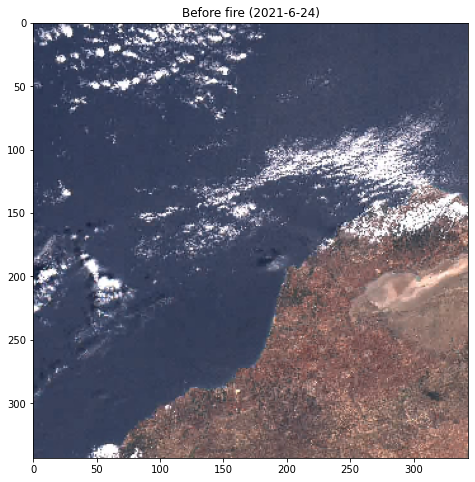

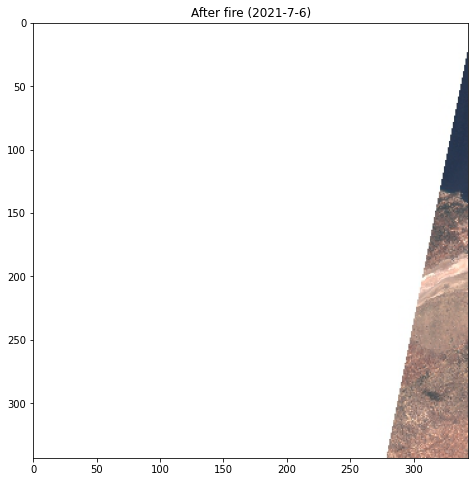

[[35.133015549128, -0.92677268966951], [36.07034215404, -0.67032866903553]]


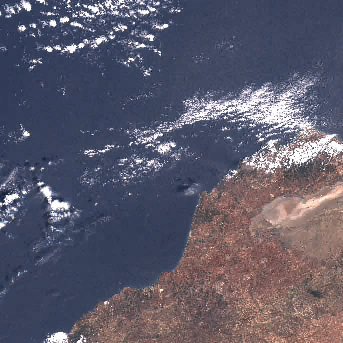

[[35.6396008844042, -0.7855991155958], [35.6485991155958, -0.7766008844042]]


width:  12
height: 4
[[35.133015549128, -0.92677268966951], [36.07034215404, -0.67032866903553]]
[[35.6396008844042, -0.7855991155958], [35.6485991155958, -0.7766008844042]]
width:  385
height: 106
[[35.133015549128, -0.92677268966951], [36.07034215404, -0.67032866903553]]
[[35.6396008844042, -0.7855991155958], [35.6485991155958, -0.7766008844042]]
width:  385
height: 106


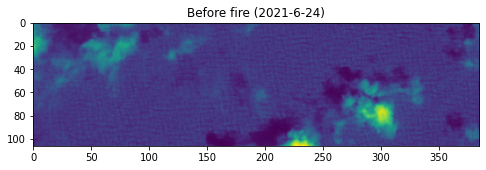

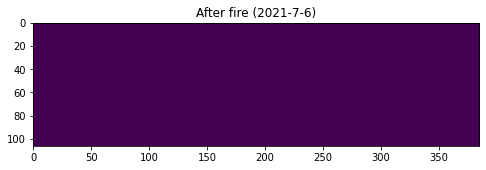

selected_row: latitude         35.6426
longitude        -0.7928
brightness         337.0
scan                 1.1
track                1.0
acq_date      2021-07-02
acq_time            1322
satellite           Aqua
instrument         MODIS
confidence            74
version             6.03
bright_t31         314.6
frp                 21.1
daynight               D
type                   0
Name: 1724842, dtype: object
2021-07-02
search_bbox: -0.7972991155957999,35.6381008844042,-0.7883008844042,35.6470991155958
8 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS2_20210706T124446_A022628_T30SXE_N03.01
  [[[[-0.67032866903553, 36.07034215404], [-0.92677268966951, 35.137159415944], [-0.69735281052744, 35.133015549128], [-0.67032866903553, 36.07034215404]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210706T124446_A022628_T30SYE_N03.01
  [[[[-0.65609673129626, 36.121949984616], [-0.79178544928712, 35.630670292374], [-0.80525750431997, 35.135018713184], [0.39831778366738, 35.107227469062], [0.4404072

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/30SXE,2021-06-24,0/
FOLDER_AFTER: ./AwsData/30SXE,2021-07-06,0/
fire_small_perimeter: [[35.6381008844042, -0.7972991155957999], [35.6470991155958, -0.7972991155957999], [35.6470991155958, -0.7883008844042], [35.6381008844042, -0.7883008844042], [35.6381008844042, -0.7972991155957999]]


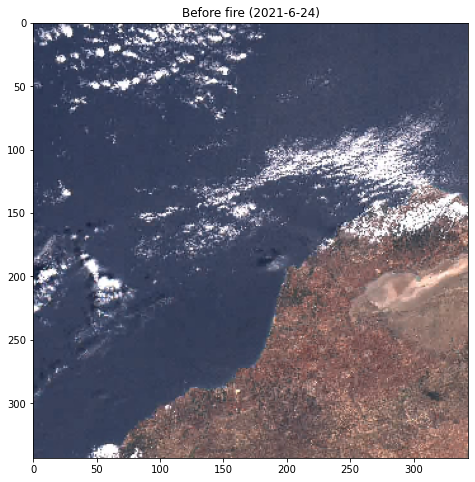

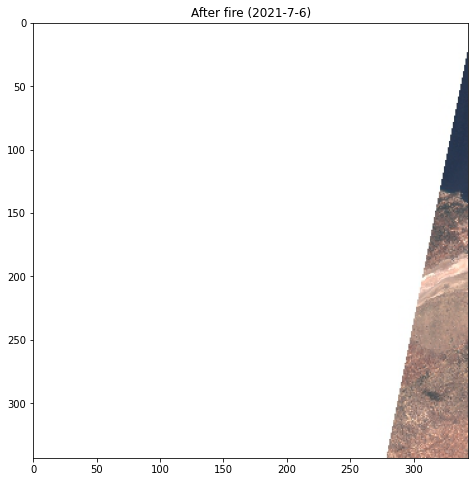

[[35.133015549128, -0.92677268966951], [36.07034215404, -0.67032866903553]]


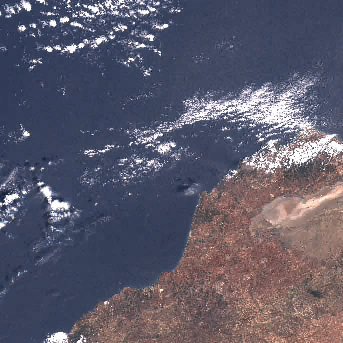

[[35.6381008844042, -0.7972991155957999], [35.6470991155958, -0.7883008844042]]


width:  12
height: 3
[[35.133015549128, -0.92677268966951], [36.07034215404, -0.67032866903553]]
[[35.6381008844042, -0.7972991155957999], [35.6470991155958, -0.7883008844042]]
width:  385
height: 105
[[35.133015549128, -0.92677268966951], [36.07034215404, -0.67032866903553]]
[[35.6381008844042, -0.7972991155957999], [35.6470991155958, -0.7883008844042]]
width:  385
height: 105


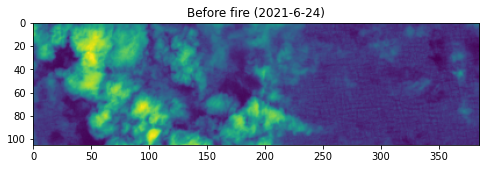

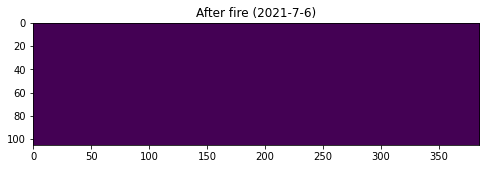

selected_row: latitude         37.6506
longitude        -8.5008
brightness         345.3
scan                 1.5
track                1.2
acq_date      2021-07-02
acq_time            1323
satellite           Aqua
instrument         MODIS
confidence            89
version             6.03
bright_t31         308.6
frp                 74.2
daynight               D
type                   0
Name: 1724844, dtype: object
2021-07-02
search_bbox: -8.5052991155958,37.6461008844042,-8.4963008844042,37.655099115595796
4 satellite moments in the interval:

S2A_OPER_MSI_L1C_TL_VGS2_20210703T133205_A031494_T29SNB_N03.01
  [[[[-9.0002162536556, 37.94758055792], [-9.000213422933, 36.957890108522], [-7.7670058357277, 36.951488599653], [-7.7506572390245, 37.940947339443], [-9.0002162536556, 37.94758055792]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210628T133007_A022514_T29SNB_N03.00
  [[[[-9.0002162536556, 37.94758055792], [-9.000213422933, 36.957890108522], [-7.7670058357277, 36.951488599653], [-7.7506572390245, 37

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/29SNB,2021-07-03,0/
fire_small_perimeter: [[37.6461008844042, -8.5052991155958], [37.655099115595796, -8.5052991155958], [37.655099115595796, -8.4963008844042], [37.6461008844042, -8.4963008844042], [37.6461008844042, -8.5052991155958]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


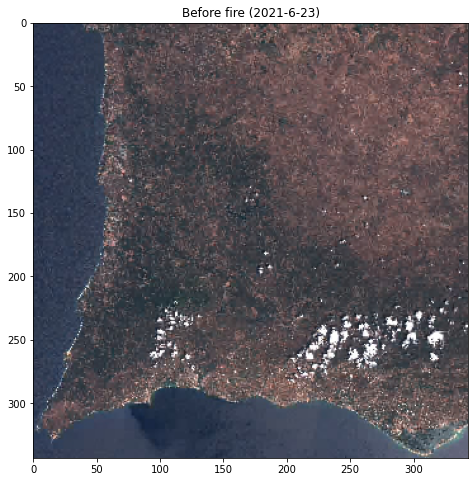

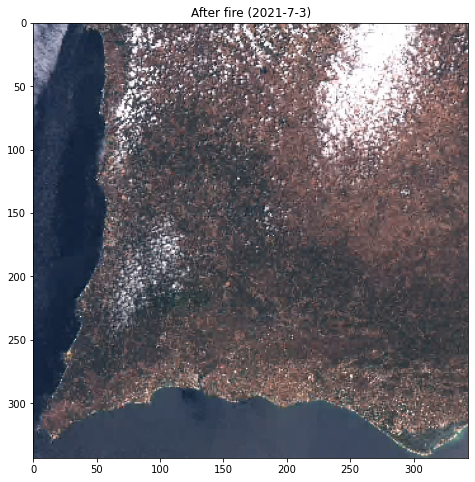

[[36.951488599653, -9.0002162536556], [37.94758055792, -7.7506572390245]]


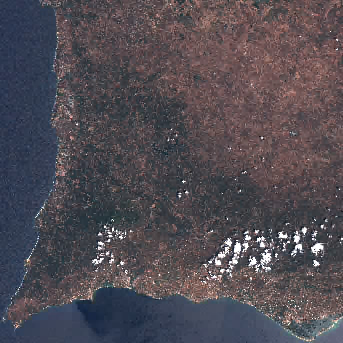

[[37.6461008844042, -8.5052991155958], [37.655099115595796, -8.4963008844042]]


width:  2
height: 3
[[36.951488599653, -9.0002162536556], [37.94758055792, -7.7506572390245]]
[[37.6461008844042, -8.5052991155958], [37.655099115595796, -8.4963008844042]]
width:  79
height: 99
[[36.951488599653, -9.0002162536556], [37.94758055792, -7.7506572390245]]
[[37.6461008844042, -8.5052991155958], [37.655099115595796, -8.4963008844042]]
width:  79
height: 99


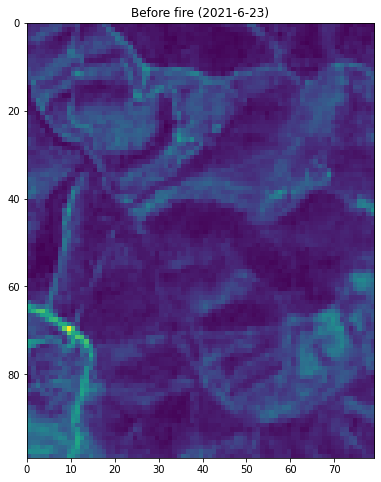

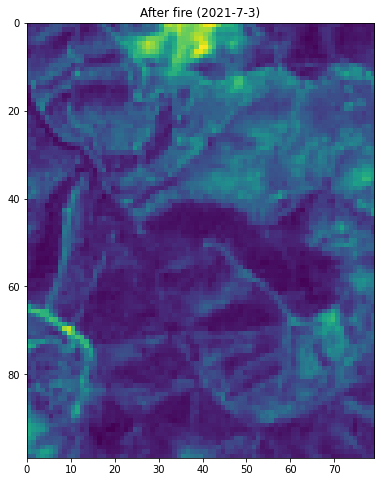

selected_row: latitude         39.1768
longitude        -1.0759
brightness         338.0
scan                 1.1
track                1.1
acq_date      2021-07-02
acq_time            1323
satellite           Aqua
instrument         MODIS
confidence            80
version             6.03
bright_t31         316.8
frp                 25.2
daynight               D
type                   0
Name: 1724845, dtype: object
2021-07-02
search_bbox: -1.0803991155958002,39.1723008844042,-1.0714008844042,39.1812991155958
2 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS2_20210629T125658_A022528_T30SXJ_N03.00
  [[[[-1.8328305271769, 39.744390769893], [-1.8491161291187, 38.75520723412], [-0.58625091211863, 38.735945671262], [-0.55212699833124, 39.724443084544], [-1.8328305271769, 39.744390769893]]]]
S2A_OPER_MSI_L1C_TL_VGS2_20210624T130055_A031365_T30SXJ_N03.00
  [[[[-1.8328305271769, 39.744390769893], [-1.8491161291187, 38.75520723412], [-0.58625091211863, 38.735945671262], [-0.5521269983

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/30SXJ,2021-06-24,0/


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/30SXJ,2021-06-29,0/
fire_small_perimeter: [[39.1723008844042, -1.0803991155958002], [39.1812991155958, -1.0803991155958002], [39.1812991155958, -1.0714008844042], [39.1723008844042, -1.0714008844042], [39.1723008844042, -1.0803991155958002]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


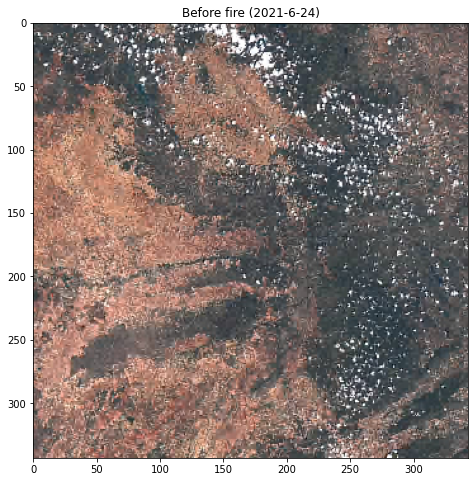

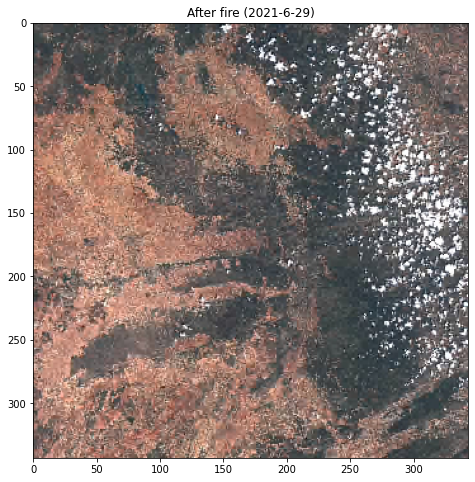

[[38.735945671262, -1.8491161291187], [39.744390769893, -0.55212699833124]]


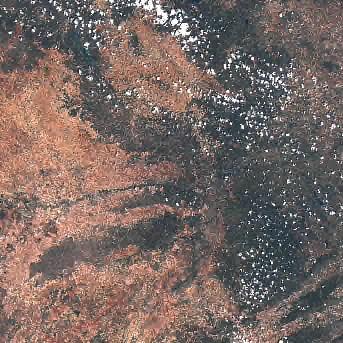

[[39.1723008844042, -1.0803991155958002], [39.1812991155958, -1.0714008844042]]


width:  3
height: 3
[[38.735945671262, -1.8491161291187], [39.744390769893, -0.55212699833124]]
[[39.1723008844042, -1.0803991155958002], [39.1812991155958, -1.0714008844042]]
width:  76
height: 98
[[38.735945671262, -1.8491161291187], [39.744390769893, -0.55212699833124]]
[[39.1723008844042, -1.0803991155958002], [39.1812991155958, -1.0714008844042]]
width:  76
height: 98


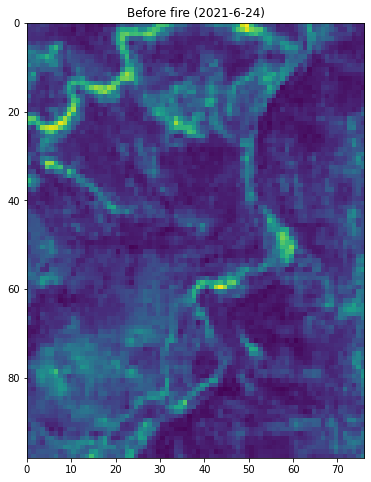

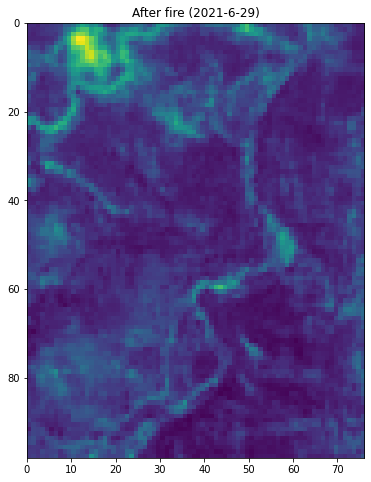

selected_row: latitude         40.6333
longitude        -3.5089
brightness         337.8
scan                 1.0
track                1.0
acq_date      2021-07-02
acq_time            1323
satellite           Aqua
instrument         MODIS
confidence            83
version             6.03
bright_t31         317.8
frp                 20.1
daynight               D
type                   0
Name: 1724847, dtype: object
2021-07-02
search_bbox: -3.5133991155958,40.6288008844042,-3.5044008844042,40.6377991155958
9 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T30TVK_N03.01
  [[[[-4.183160622934, 40.644785917695], [-4.1661201925602, 39.655761697223], [-3.6487898531011, 39.659803880505], [-3.2960002506237, 40.650468138552], [-4.183160622934, 40.644785917695]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T30TVL_N03.01
  [[[[-4.1994369480153, 41.54557988694], [-4.1816086414788, 40.55671603881], [-3.3274976734167, 40.562294736777], [-3.107385651136, 41.1

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/30TVK,2021-06-27,0/


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/30TVK,2021-07-05,0/
fire_small_perimeter: [[40.6288008844042, -3.5133991155958], [40.6377991155958, -3.5133991155958], [40.6377991155958, -3.5044008844042], [40.6288008844042, -3.5044008844042], [40.6288008844042, -3.5133991155958]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


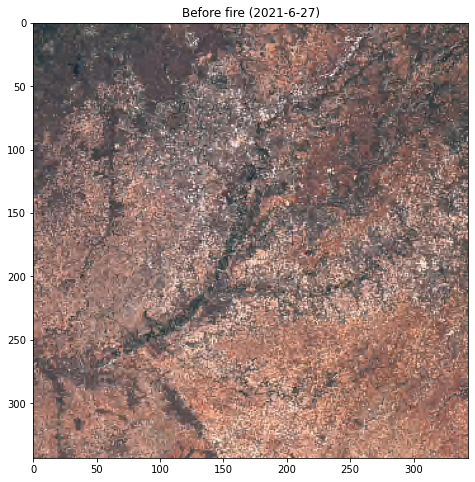

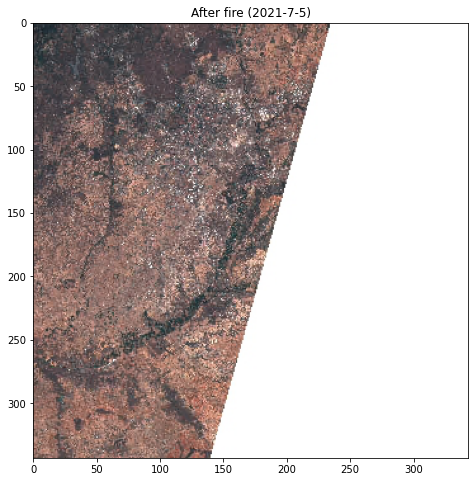

[[39.655761697223, -4.183160622934], [40.650468138552, -3.2960002506237]]


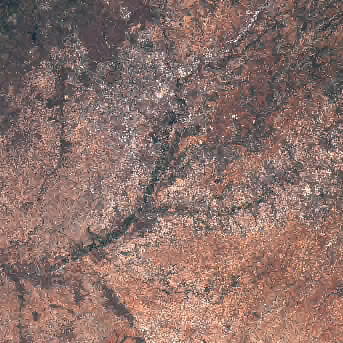

[[40.6288008844042, -3.5133991155958], [40.6377991155958, -3.5044008844042]]


width:  3
height: 3
[[39.655761697223, -4.183160622934], [40.650468138552, -3.2960002506237]]
[[40.6288008844042, -3.5133991155958], [40.6377991155958, -3.5044008844042]]
width:  112
height: 99
[[39.655761697223, -4.183160622934], [40.650468138552, -3.2960002506237]]
[[40.6288008844042, -3.5133991155958], [40.6377991155958, -3.5044008844042]]
width:  112
height: 99


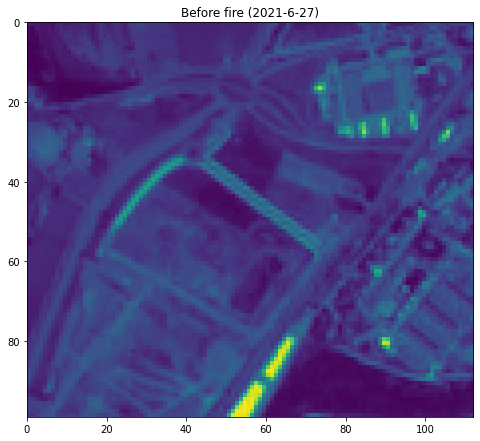

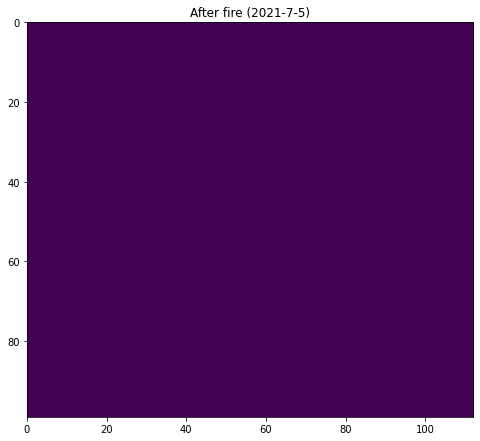

selected_row: latitude         40.6349
longitude        -3.4972
brightness         342.1
scan                 1.0
track                1.0
acq_date      2021-07-02
acq_time            1323
satellite           Aqua
instrument         MODIS
confidence            87
version             6.03
bright_t31         318.3
frp                 27.4
daynight               D
type                   0
Name: 1724848, dtype: object
2021-07-02
search_bbox: -3.5016991155958,40.6304008844042,-3.4927008844042,40.6393991155958
9 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T30TVK_N03.01
  [[[[-4.183160622934, 40.644785917695], [-4.1661201925602, 39.655761697223], [-3.6487898531011, 39.659803880505], [-3.2960002506237, 40.650468138552], [-4.183160622934, 40.644785917695]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T30TVL_N03.01
  [[[[-4.1994369480153, 41.54557988694], [-4.1816086414788, 40.55671603881], [-3.3274976734167, 40.562294736777], [-3.107385651136, 41.1

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/30TVK,2021-06-27,0/
FOLDER_AFTER: ./AwsData/30TVK,2021-07-05,0/
fire_small_perimeter: [[40.6304008844042, -3.5016991155958], [40.6393991155958, -3.5016991155958], [40.6393991155958, -3.4927008844042], [40.6304008844042, -3.4927008844042], [40.6304008844042, -3.5016991155958]]


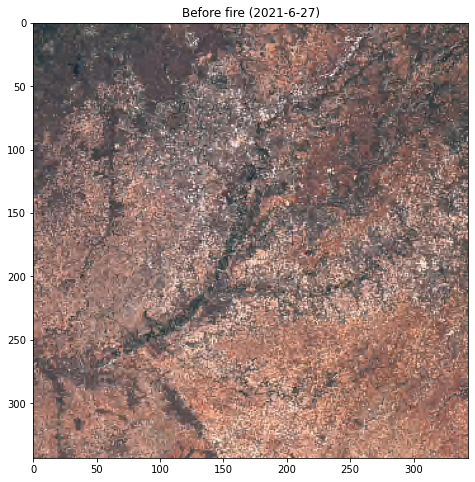

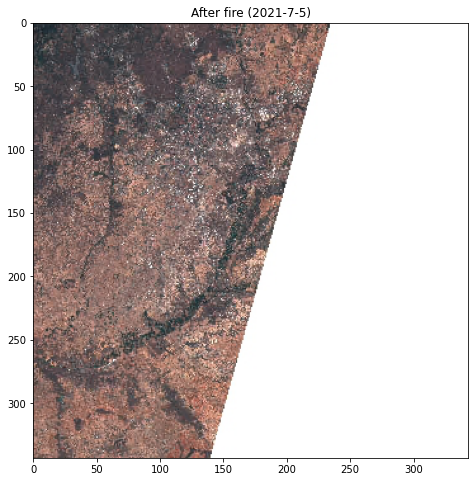

[[39.655761697223, -4.183160622934], [40.650468138552, -3.2960002506237]]


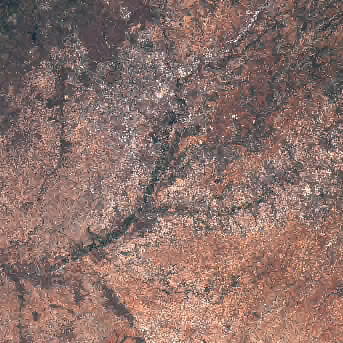

[[40.6304008844042, -3.5016991155958], [40.6393991155958, -3.4927008844042]]


width:  4
height: 3
[[39.655761697223, -4.183160622934], [40.650468138552, -3.2960002506237]]
[[40.6304008844042, -3.5016991155958], [40.6393991155958, -3.4927008844042]]
width:  112
height: 100
[[39.655761697223, -4.183160622934], [40.650468138552, -3.2960002506237]]
[[40.6304008844042, -3.5016991155958], [40.6393991155958, -3.4927008844042]]
width:  112
height: 100


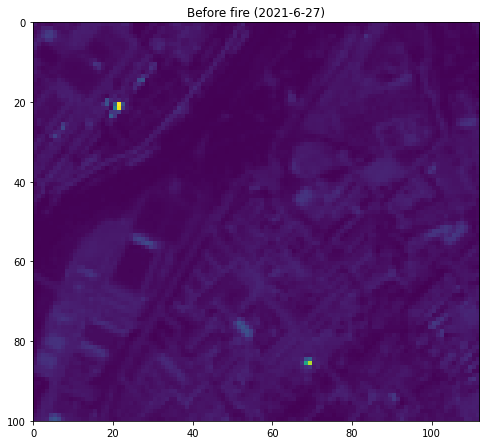

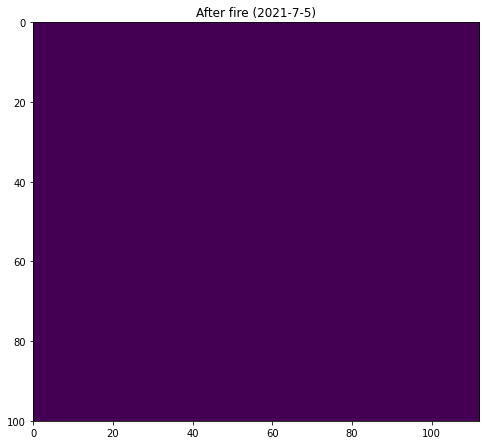

selected_row: latitude         38.3423
longitude        -5.9648
brightness         309.2
scan                 1.4
track                1.2
acq_date      2021-07-02
acq_time            2245
satellite          Terra
instrument         MODIS
confidence            77
version             6.03
bright_t31         292.6
frp                 15.4
daynight               N
type                   0
Name: 1728592, dtype: object
2021-07-02
search_bbox: -5.9692991155958,38.3378008844042,-5.960300884404201,38.3467991155958
6 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T29SQC_N03.01
  [[[[-6.6965183750648, 38.826272476229], [-6.7276241741142, 37.837520971374], [-5.4816486496777, 37.806866366148], [-5.4335591203171, 38.794518595371], [-6.6965183750648, 38.826272476229]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T30STH_N03.01
  [[[[-6.4544910542227, 38.797885991096], [-6.4079037522404, 37.810117230784], [-5.1617638158098, 37.83960429136], [-5.1913584932417

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/29SQC,2021-07-05,0/
fire_small_perimeter: [[38.3378008844042, -5.9692991155958], [38.3467991155958, -5.9692991155958], [38.3467991155958, -5.960300884404201], [38.3378008844042, -5.960300884404201], [38.3378008844042, -5.9692991155958]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


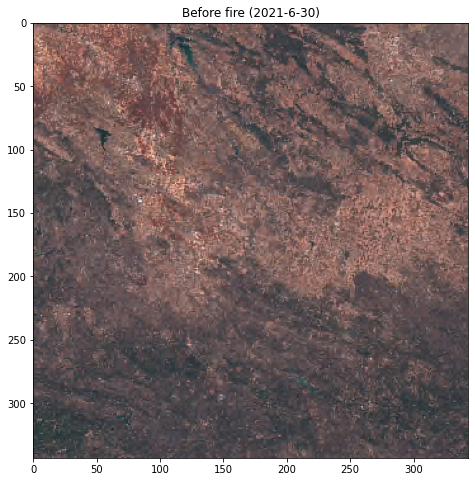

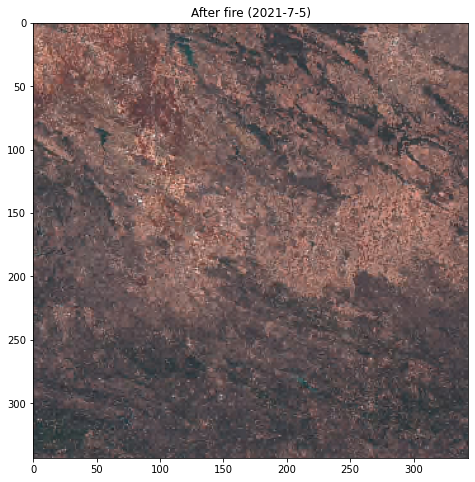

[[37.806866366148, -6.7276241741142], [38.826272476229, -5.4335591203171]]


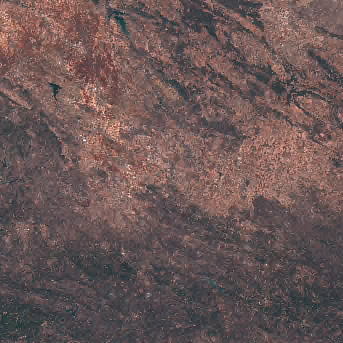

[[38.3378008844042, -5.9692991155958], [38.3467991155958, -5.960300884404201]]


width:  2
height: 3
[[37.806866366148, -6.7276241741142], [38.826272476229, -5.4335591203171]]
[[38.3378008844042, -5.9692991155958], [38.3467991155958, -5.960300884404201]]
width:  77
height: 97
[[37.806866366148, -6.7276241741142], [38.826272476229, -5.4335591203171]]
[[38.3378008844042, -5.9692991155958], [38.3467991155958, -5.960300884404201]]
width:  77
height: 97


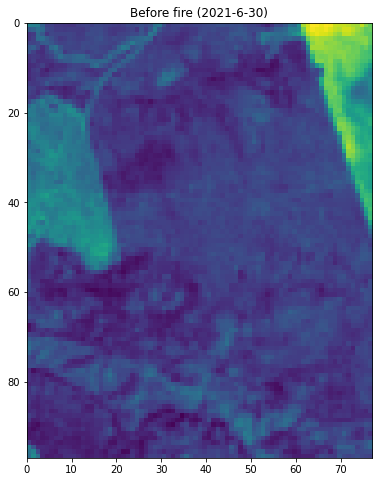

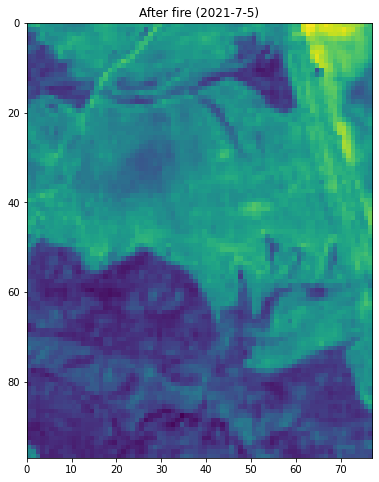

selected_row: latitude         43.1688
longitude         3.1335
brightness         340.7
scan                 1.0
track                1.0
acq_date      2021-07-03
acq_time            1044
satellite          Terra
instrument         MODIS
confidence            90
version             6.03
bright_t31         285.2
frp                 39.2
daynight               D
type                   0
Name: 1737220, dtype: object
2021-07-03
search_bbox: 3.1290008844042,43.1643008844042,3.1379991155958002,43.173299115595796
3 satellite moments in the interval:

S2A_OPER_MSI_L1C_TL_VGS2_20210701T124711_A031465_T31TEH_N03.01
  [[[[2.9997655490349, 43.352846387415], [2.9997692602606, 42.364080925951], [4.3330026597313, 42.356331534308], [4.3544347953874, 43.344825960105], [2.9997655490349, 43.352846387415]]]]
S2B_OPER_MSI_L1C_TL_VGS4_20210626T114048_A022485_T31TEH_N03.00
  [[[[2.9997655490349, 43.352846387415], [2.9997692602606, 42.364080925951], [4.3330026597313, 42.356331534308], [4.3544347953874, 43.34

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/31TEH,2021-06-21,0/


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/31TEH,2021-07-01,0/
fire_small_perimeter: [[43.1643008844042, 3.1290008844042], [43.173299115595796, 3.1290008844042], [43.173299115595796, 3.1379991155958002], [43.1643008844042, 3.1379991155958002], [43.1643008844042, 3.1290008844042]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


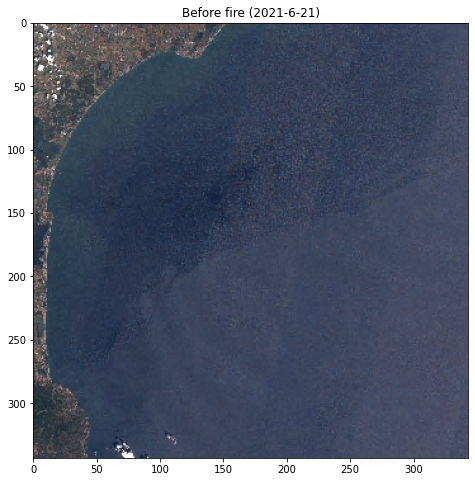

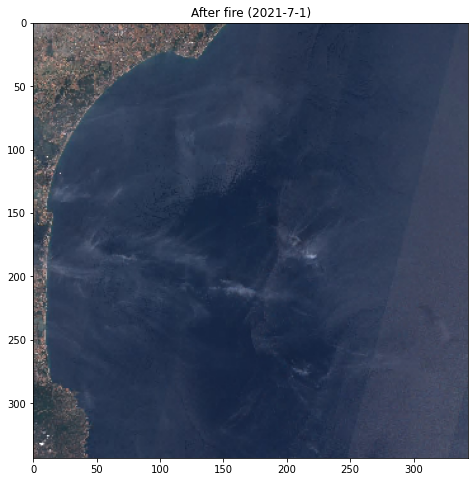

[[42.356331534308, 2.9997655490349], [43.352846387415, 4.3544347953874]]


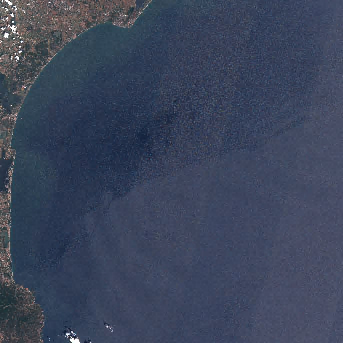

[[43.1643008844042, 3.1290008844042], [43.173299115595796, 3.1379991155958002]]


width:  2
height: 3
[[42.356331534308, 2.9997655490349], [43.352846387415, 4.3544347953874]]
[[43.1643008844042, 3.1290008844042], [43.173299115595796, 3.1379991155958002]]
width:  73
height: 99
[[42.356331534308, 2.9997655490349], [43.352846387415, 4.3544347953874]]
[[43.1643008844042, 3.1290008844042], [43.173299115595796, 3.1379991155958002]]
width:  73
height: 99


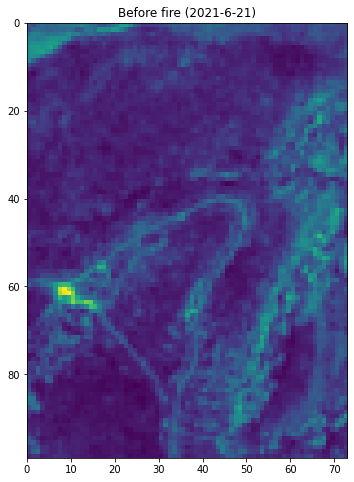

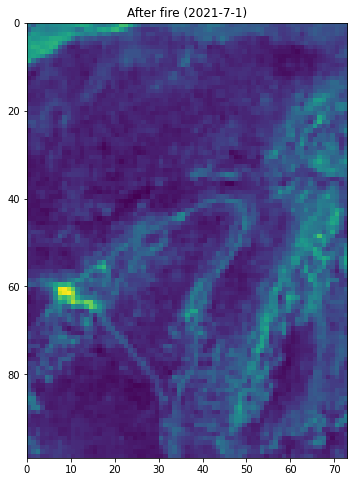

selected_row: latitude         35.4507
longitude        -1.1464
brightness         325.2
scan                 4.3
track                1.9
acq_date      2021-07-03
acq_time            1405
satellite           Aqua
instrument         MODIS
confidence            78
version             6.03
bright_t31         304.4
frp                 75.6
daynight               D
type                   0
Name: 1751712, dtype: object
2021-07-03
search_bbox: -1.1508991155958002,35.4462008844042,-1.1419008844042,35.455199115595796
3 satellite moments in the interval:

S2A_OPER_MSI_L1C_TL_VGS2_20210704T130823_A031508_T30SXE_N03.01
  [[[[-1.8885084389135, 36.139731612507], [-1.9021350633104, 35.149924953214], [-0.69735281052744, 35.133015549128], [-0.66879672968576, 36.122197934857], [-1.8885084389135, 36.139731612507]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210629T125658_A022528_T30SXE_N03.00
  [[[[-1.8885084389135, 36.139731612507], [-1.9021350633104, 35.149924953214], [-0.69735281052744, 35.133015549128], [-0.668796

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/30SXE,2021-06-24,0/


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/30SXE,2021-07-04,0/
fire_small_perimeter: [[35.4462008844042, -1.1508991155958002], [35.455199115595796, -1.1508991155958002], [35.455199115595796, -1.1419008844042], [35.4462008844042, -1.1419008844042], [35.4462008844042, -1.1508991155958002]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


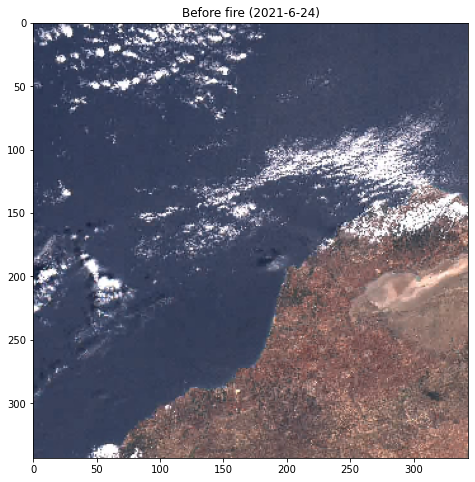

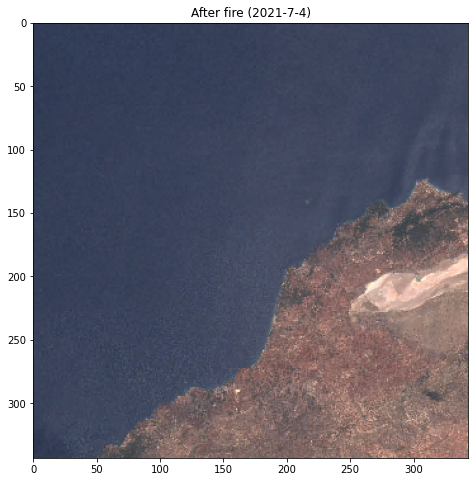

[[35.133015549128, -1.9021350633104], [36.139731612507, -0.66879672968576]]


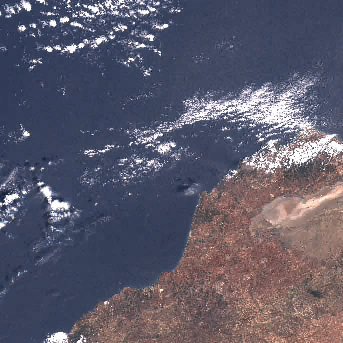

[[35.4462008844042, -1.1508991155958002], [35.455199115595796, -1.1419008844042]]


width:  2
height: 3
[[35.133015549128, -1.9021350633104], [36.139731612507, -0.66879672968576]]
[[35.4462008844042, -1.1508991155958002], [35.455199115595796, -1.1419008844042]]
width:  80
height: 98
[[35.133015549128, -1.9021350633104], [36.139731612507, -0.66879672968576]]
[[35.4462008844042, -1.1508991155958002], [35.455199115595796, -1.1419008844042]]
width:  80
height: 98


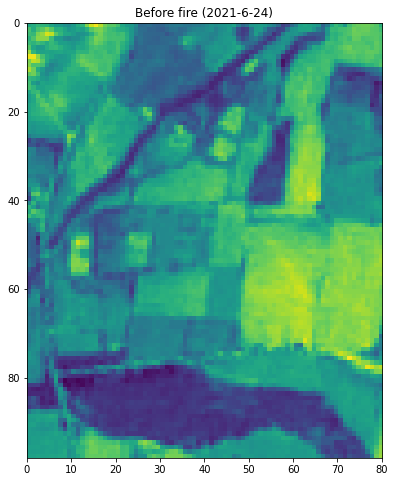

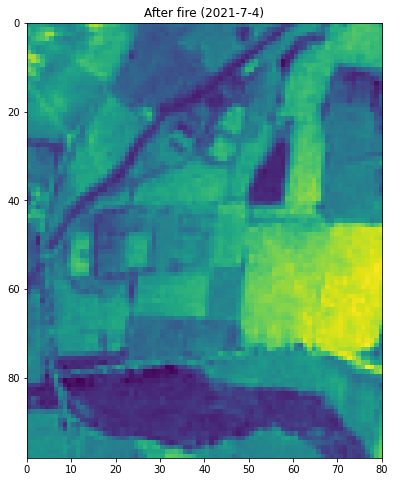

selected_row: latitude         38.5554
longitude        -4.3418
brightness         353.3
scan                 2.9
track                1.6
acq_date      2021-07-03
acq_time            1406
satellite           Aqua
instrument         MODIS
confidence            96
version             6.03
bright_t31         314.7
frp                242.3
daynight               D
type                   0
Name: 1751713, dtype: object
2021-07-03
search_bbox: -4.3462991155958,38.5509008844042,-4.3373008844042005,38.5598991155958
6 satellite moments in the interval:

S2A_OPER_MSI_L1C_TL_VGS2_20210707T131101_A031551_T30SUH_N03.01
  [[[[-4.9046111792011, 38.833459578438], [-5.0654895939972, 38.279954909929], [-5.1946361979258, 37.838996018621], [-4.0253480496342, 37.854986574359], [-4.0393956703758, 38.844364822283], [-4.9046111792011, 38.833459578438]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T30SUH_N03.01
  [[[[-5.3039190425813, 38.826263846154], [-5.2728073492047, 37.837512640186], [-4.27132830283

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/30SUH,2021-06-27,0/


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/30SUH,2021-07-07,0/
fire_small_perimeter: [[38.5509008844042, -4.3462991155958], [38.5598991155958, -4.3462991155958], [38.5598991155958, -4.3373008844042005], [38.5509008844042, -4.3373008844042005], [38.5509008844042, -4.3462991155958]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


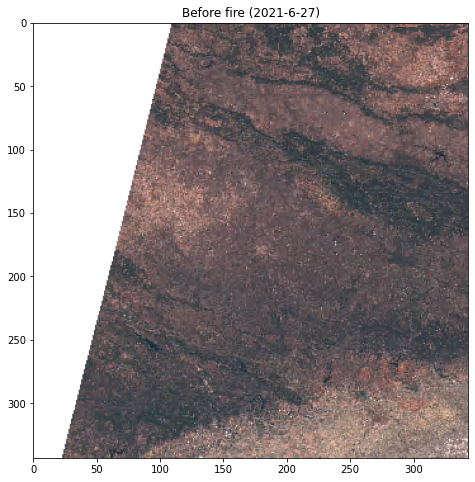

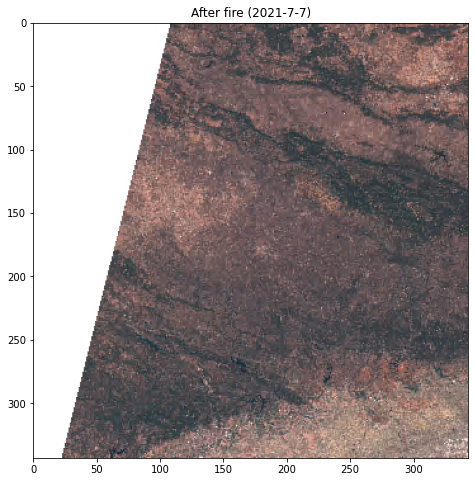

[[37.838996018621, -5.1946361979258], [38.844364822283, -4.0253480496342]]


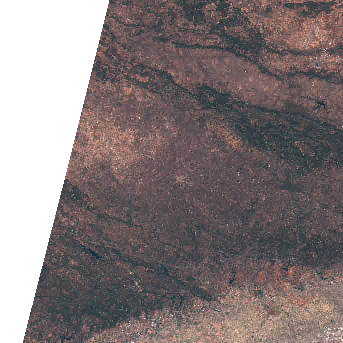

[[38.5509008844042, -4.3462991155958], [38.5598991155958, -4.3373008844042005]]


width:  2
height: 3
[[37.838996018621, -5.1946361979258], [38.844364822283, -4.0253480496342]]
[[38.5509008844042, -4.3462991155958], [38.5598991155958, -4.3373008844042005]]
width:  85
height: 98
[[37.838996018621, -5.1946361979258], [38.844364822283, -4.0253480496342]]
[[38.5509008844042, -4.3462991155958], [38.5598991155958, -4.3373008844042005]]
width:  85
height: 98


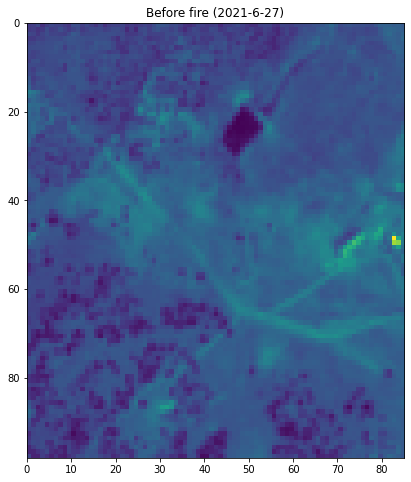

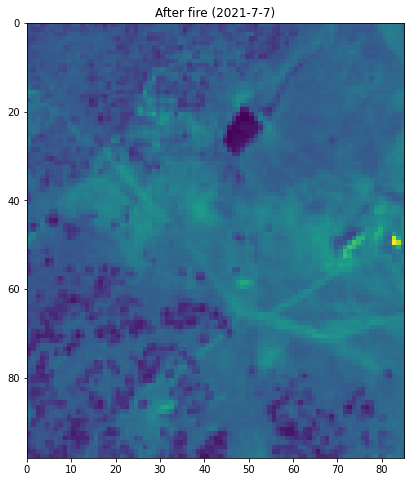

selected_row: latitude           38.57
longitude        -4.3429
brightness         342.1
scan                 2.9
track                1.6
acq_date      2021-07-03
acq_time            1406
satellite           Aqua
instrument         MODIS
confidence            87
version             6.03
bright_t31         314.2
frp                130.8
daynight               D
type                   0
Name: 1751714, dtype: object
2021-07-03
search_bbox: -4.3473991155958,38.5655008844042,-4.338400884404201,38.5744991155958
6 satellite moments in the interval:

S2A_OPER_MSI_L1C_TL_VGS2_20210707T131101_A031551_T30SUH_N03.01
  [[[[-4.9046111792011, 38.833459578438], [-5.0654895939972, 38.279954909929], [-5.1946361979258, 37.838996018621], [-4.0253480496342, 37.854986574359], [-4.0393956703758, 38.844364822283], [-4.9046111792011, 38.833459578438]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T30SUH_N03.01
  [[[[-5.3039190425813, 38.826263846154], [-5.2728073492047, 37.837512640186], [-4.271328302834

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/30SUH,2021-06-27,0/
FOLDER_AFTER: ./AwsData/30SUH,2021-07-07,0/
fire_small_perimeter: [[38.5655008844042, -4.3473991155958], [38.5744991155958, -4.3473991155958], [38.5744991155958, -4.338400884404201], [38.5655008844042, -4.338400884404201], [38.5655008844042, -4.3473991155958]]


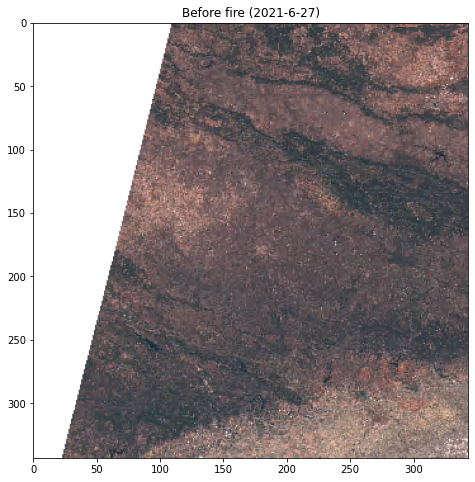

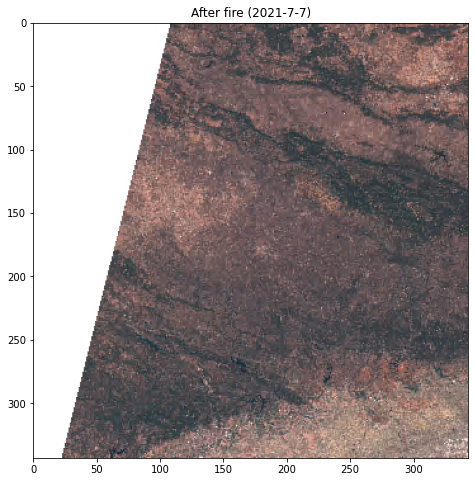

[[37.838996018621, -5.1946361979258], [38.844364822283, -4.0253480496342]]


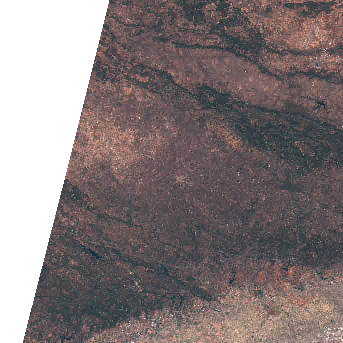

[[38.5655008844042, -4.3473991155958], [38.5744991155958, -4.338400884404201]]


width:  2
height: 3
[[37.838996018621, -5.1946361979258], [38.844364822283, -4.0253480496342]]
[[38.5655008844042, -4.3473991155958], [38.5744991155958, -4.338400884404201]]
width:  84
height: 99
[[37.838996018621, -5.1946361979258], [38.844364822283, -4.0253480496342]]
[[38.5655008844042, -4.3473991155958], [38.5744991155958, -4.338400884404201]]
width:  84
height: 99


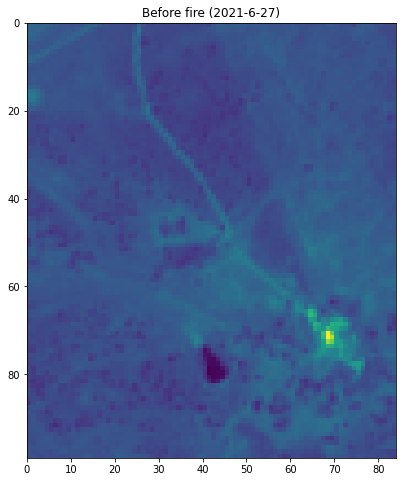

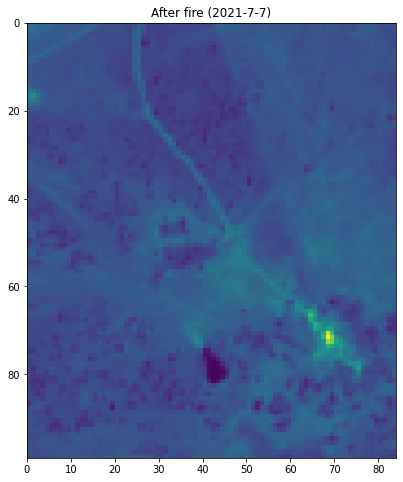

selected_row: latitude          39.245
longitude         -7.036
brightness         333.7
scan                 1.0
track                1.0
acq_date      2021-07-04
acq_time            1128
satellite          Terra
instrument         MODIS
confidence            81
version             6.03
bright_t31         310.2
frp                 18.6
daynight               D
type                   0
Name: 1765833, dtype: object
2021-07-04
search_bbox: -7.040499115595799,39.2405008844042,-7.0315008844042,39.249499115595796
7 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS4_20210708T123423_A022657_T29SPD_N03.01
  [[[[-7.8328305271769, 39.744390769893], [-7.8491161291187, 38.75520723412], [-6.5862509121186, 38.735945671262], [-6.5521269983312, 39.724443084544], [-7.8328305271769, 39.744390769893]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T29SPD_N03.01
  [[[[-7.1617243714537, 39.735701404696], [-7.2853084592637, 39.316478684206], [-7.4535345127259, 38.750642231736], [-6.58625091211

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/29SPD,2021-07-05,0/
fire_small_perimeter: [[39.2405008844042, -7.040499115595799], [39.249499115595796, -7.040499115595799], [39.249499115595796, -7.0315008844042], [39.2405008844042, -7.0315008844042], [39.2405008844042, -7.040499115595799]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


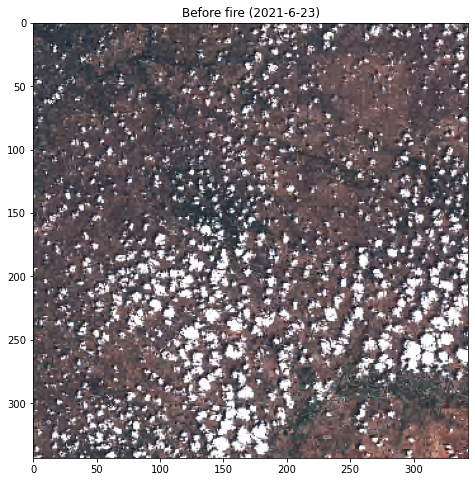

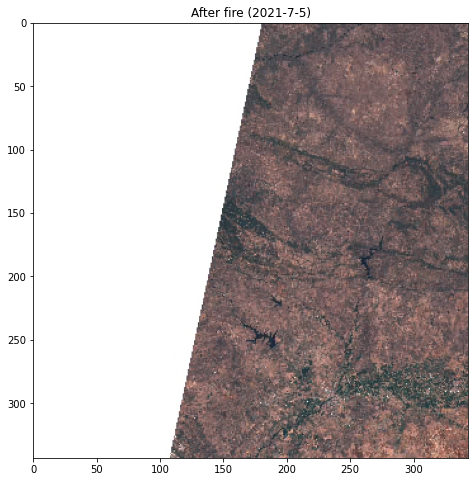

[[38.735945671262, -7.4535345127259], [39.735701404696, -6.5521269983312]]


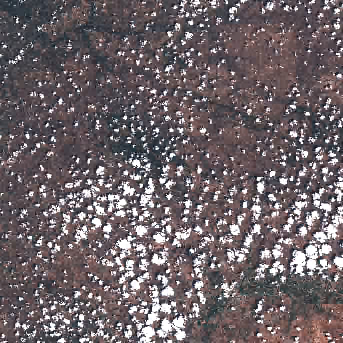

[[39.2405008844042, -7.040499115595799], [39.249499115595796, -7.0315008844042]]


width:  4
height: 3
[[38.735945671262, -7.4535345127259], [39.735701404696, -6.5521269983312]]
[[39.2405008844042, -7.040499115595799], [39.249499115595796, -7.0315008844042]]
width:  110
height: 99
[[38.735945671262, -7.4535345127259], [39.735701404696, -6.5521269983312]]
[[39.2405008844042, -7.040499115595799], [39.249499115595796, -7.0315008844042]]
width:  110
height: 99


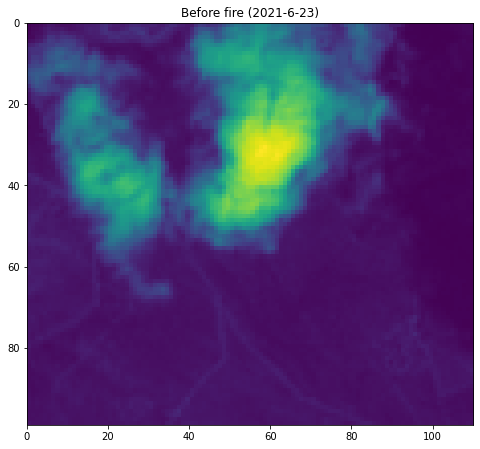

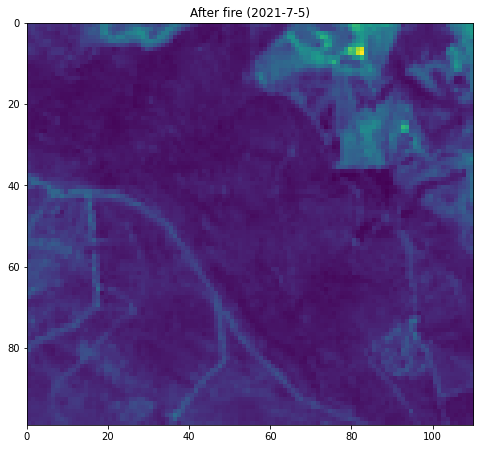

selected_row: latitude         39.2469
longitude        -7.0478
brightness         331.6
scan                 1.0
track                1.0
acq_date      2021-07-04
acq_time            1128
satellite          Terra
instrument         MODIS
confidence            76
version             6.03
bright_t31         310.3
frp                 15.9
daynight               D
type                   0
Name: 1765834, dtype: object
2021-07-04
search_bbox: -7.052299115595799,39.2424008844042,-7.0433008844042,39.251399115595795
7 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS4_20210708T123423_A022657_T29SPD_N03.01
  [[[[-7.8328305271769, 39.744390769893], [-7.8491161291187, 38.75520723412], [-6.5862509121186, 38.735945671262], [-6.5521269983312, 39.724443084544], [-7.8328305271769, 39.744390769893]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T29SPD_N03.01
  [[[[-7.1617243714537, 39.735701404696], [-7.2853084592637, 39.316478684206], [-7.4535345127259, 38.750642231736], [-6.58625091211

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/29SPD,2021-06-23,0/
FOLDER_AFTER: ./AwsData/29SPD,2021-07-05,0/
fire_small_perimeter: [[39.2424008844042, -7.052299115595799], [39.251399115595795, -7.052299115595799], [39.251399115595795, -7.0433008844042], [39.2424008844042, -7.0433008844042], [39.2424008844042, -7.052299115595799]]


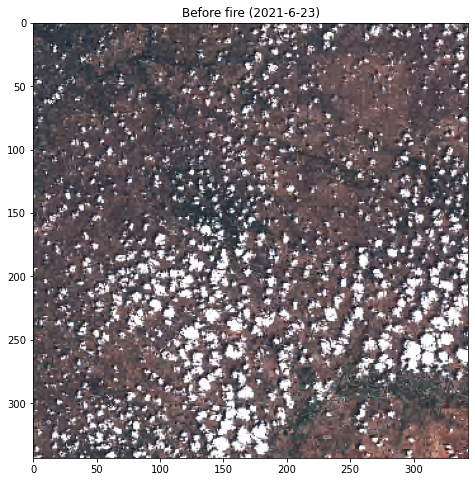

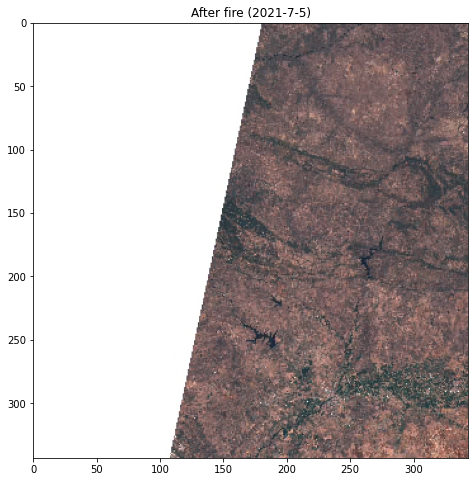

[[38.735945671262, -7.4535345127259], [39.735701404696, -6.5521269983312]]


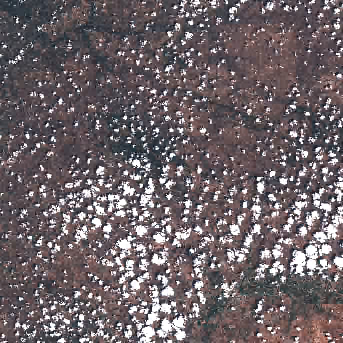

[[39.2424008844042, -7.052299115595799], [39.251399115595795, -7.0433008844042]]


width:  3
height: 3
[[38.735945671262, -7.4535345127259], [39.735701404696, -6.5521269983312]]
[[39.2424008844042, -7.052299115595799], [39.251399115595795, -7.0433008844042]]
width:  110
height: 99
[[38.735945671262, -7.4535345127259], [39.735701404696, -6.5521269983312]]
[[39.2424008844042, -7.052299115595799], [39.251399115595795, -7.0433008844042]]
width:  110
height: 99


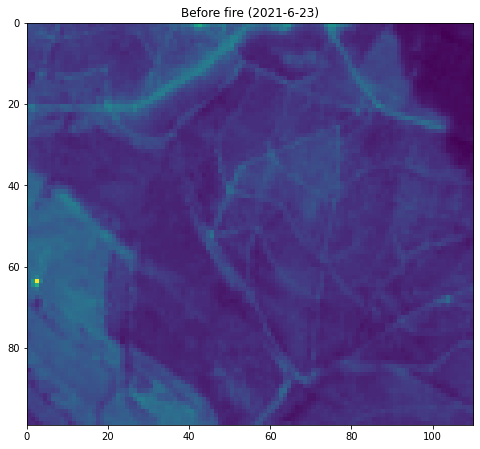

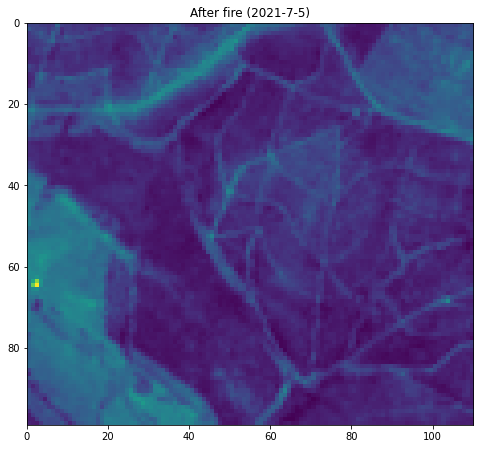

selected_row: latitude         36.5669
longitude         2.2169
brightness         385.2
scan                 1.1
track                1.0
acq_date      2021-07-04
acq_time            1310
satellite           Aqua
instrument         MODIS
confidence           100
version             6.03
bright_t31         313.0
frp                175.9
daynight               D
type                   0
Name: 1768845, dtype: object
2021-07-04
search_bbox: 2.2124008844042,36.5624008844042,2.2213991155958,36.571399115595796
6 satellite moments in the interval:

S2A_OPER_MSI_L1C_TL_VGS2_20210708T123744_A031565_T31SDA_N03.01
  [[[[2.1285333541226, 37.043373423328], [1.995091075703, 36.570191469075], [1.9543795443264, 36.417428359802], [1.88743904236, 36.185531110073], [1.8893272617186, 36.051587828664], [3.1083573665034, 36.056684010167], [3.1097480619864, 37.046523275889], [2.1285333541226, 37.043373423328]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210706T124446_A022628_T31SDA_N03.01
  [[[[1.8750761132301, 37.04124087

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/31SDA,2021-07-08,0/
fire_small_perimeter: [[36.5624008844042, 2.2124008844042], [36.571399115595796, 2.2124008844042], [36.571399115595796, 2.2213991155958], [36.5624008844042, 2.2213991155958], [36.5624008844042, 2.2124008844042]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


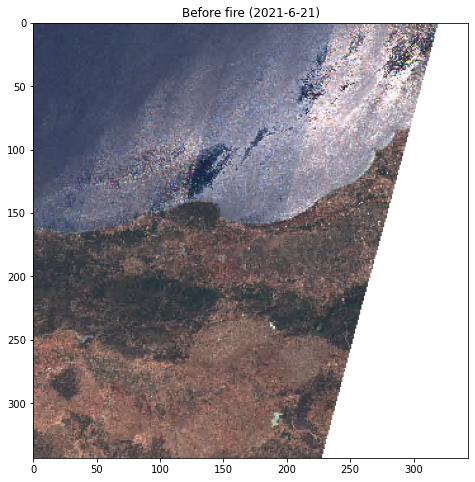

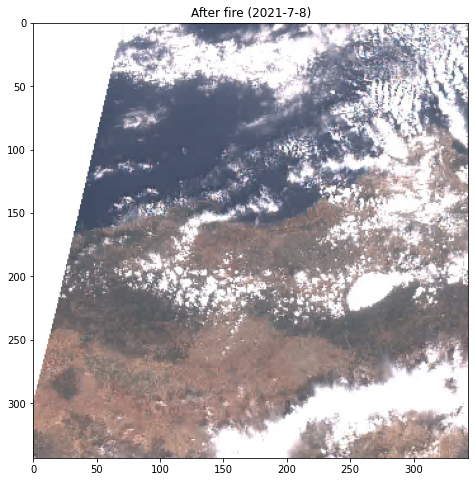

[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]


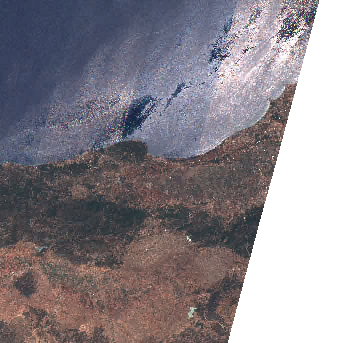

[[36.5624008844042, 2.2124008844042], [36.571399115595796, 2.2213991155958]]


width:  3
height: 3
[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]
[[36.5624008844042, 2.2124008844042], [36.571399115595796, 2.2213991155958]]
width:  81
height: 100
[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]
[[36.5624008844042, 2.2124008844042], [36.571399115595796, 2.2213991155958]]
width:  81
height: 100


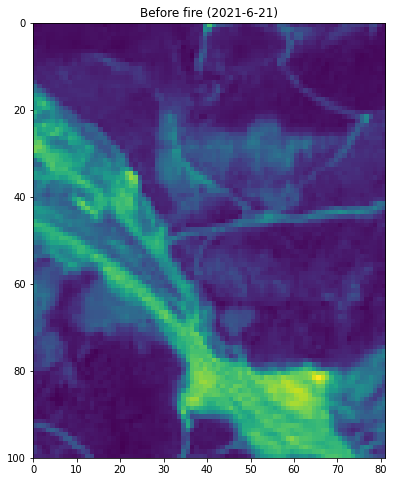

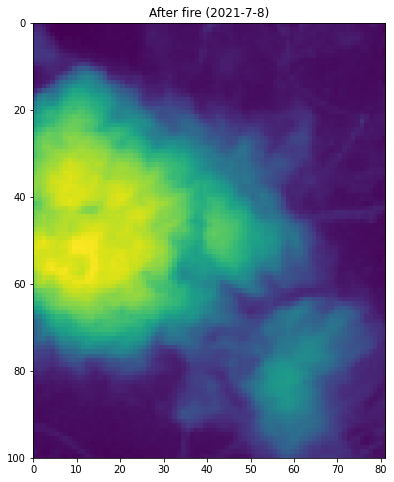

selected_row: latitude         36.5654
longitude         2.2048
brightness         367.3
scan                 1.1
track                1.0
acq_date      2021-07-04
acq_time            1310
satellite           Aqua
instrument         MODIS
confidence           100
version             6.03
bright_t31         312.1
frp                100.4
daynight               D
type                   0
Name: 1768846, dtype: object
2021-07-04
search_bbox: 2.2003008844042,36.5609008844042,2.2092991155958,36.569899115595796
6 satellite moments in the interval:

S2A_OPER_MSI_L1C_TL_VGS2_20210708T123744_A031565_T31SDA_N03.01
  [[[[2.1285333541226, 37.043373423328], [1.995091075703, 36.570191469075], [1.9543795443264, 36.417428359802], [1.88743904236, 36.185531110073], [1.8893272617186, 36.051587828664], [3.1083573665034, 36.056684010167], [3.1097480619864, 37.046523275889], [2.1285333541226, 37.043373423328]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210706T124446_A022628_T31SDA_N03.01
  [[[[1.8750761132301, 37.04124087

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/31SDA,2021-06-21,0/
FOLDER_AFTER: ./AwsData/31SDA,2021-07-08,0/
fire_small_perimeter: [[36.5609008844042, 2.2003008844042], [36.569899115595796, 2.2003008844042], [36.569899115595796, 2.2092991155958], [36.5609008844042, 2.2092991155958], [36.5609008844042, 2.2003008844042]]


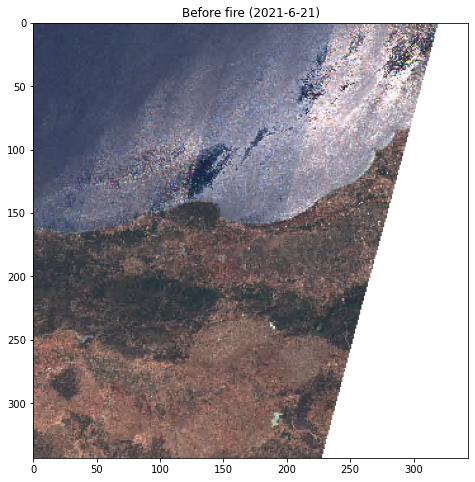

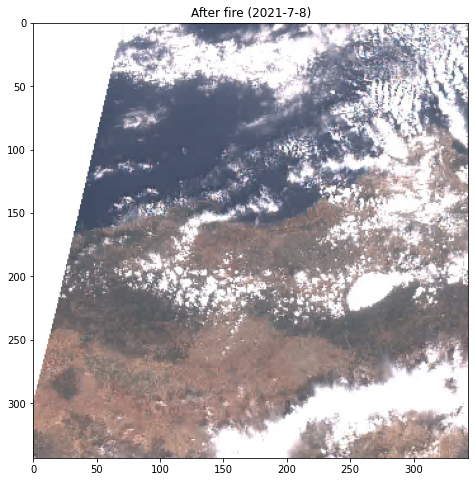

[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]


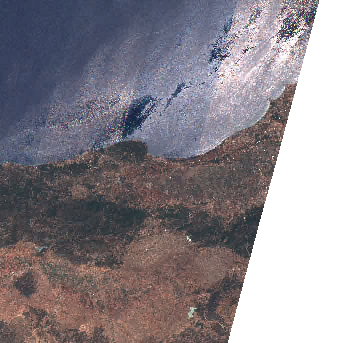

[[36.5609008844042, 2.2003008844042], [36.569899115595796, 2.2092991155958]]


width:  2
height: 3
[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]
[[36.5609008844042, 2.2003008844042], [36.569899115595796, 2.2092991155958]]
width:  81
height: 99
[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]
[[36.5609008844042, 2.2003008844042], [36.569899115595796, 2.2092991155958]]
width:  81
height: 99


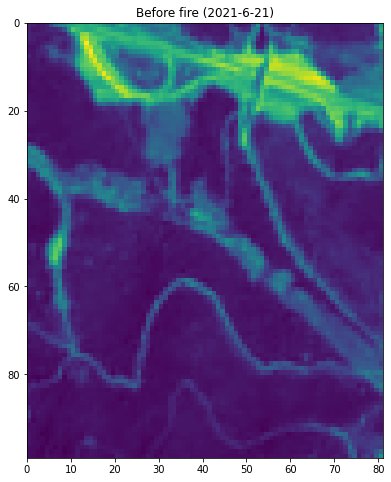

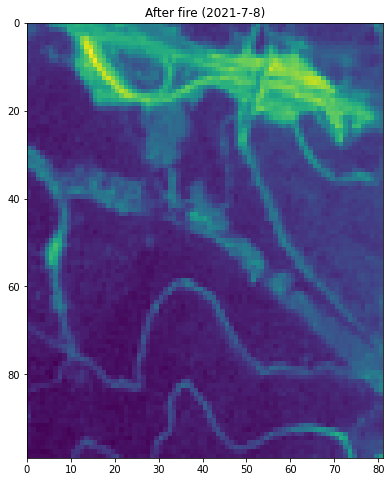

selected_row: latitude         41.9323
longitude        -5.3092
brightness         325.4
scan                 4.0
track                1.9
acq_date      2021-07-05
acq_time            1210
satellite          Terra
instrument         MODIS
confidence            80
version             6.03
bright_t31         300.6
frp                118.2
daynight               D
type                   0
Name: 1786943, dtype: object
2021-07-05
search_bbox: -5.313699115595799,41.9278008844042,-5.3047008844042,41.9367991155958
9 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T30TTM_N03.01
  [[[[-6.3383913011071, 42.404043852148], [-6.3609973249227, 42.325356160405], [-6.598705291445, 41.57844229373], [-6.5892572504445, 41.407735551467], [-5.2769788443522, 41.441220929794], [-5.3124190586532, 42.429351627941], [-6.3383913011071, 42.404043852148]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T29TQG_N03.01
  [[[[-6.3324555021772, 42.421633042658], [-6.3610980849497,

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/30TTM,2021-07-05,0/
fire_small_perimeter: [[41.9278008844042, -5.313699115595799], [41.9367991155958, -5.313699115595799], [41.9367991155958, -5.3047008844042], [41.9278008844042, -5.3047008844042], [41.9278008844042, -5.313699115595799]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


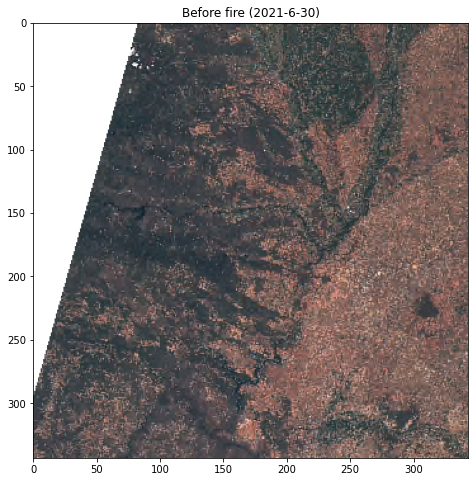

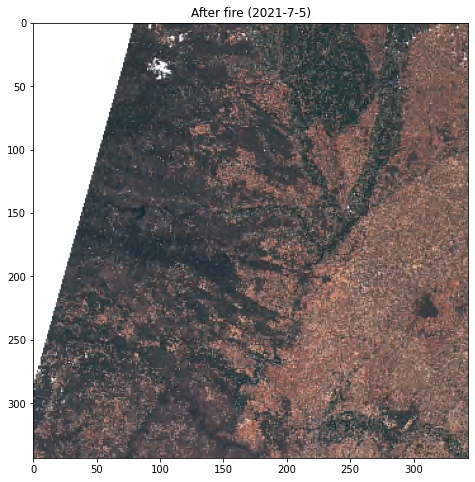

[[41.407735551467, -6.598705291445], [42.429351627941, -5.2769788443522]]


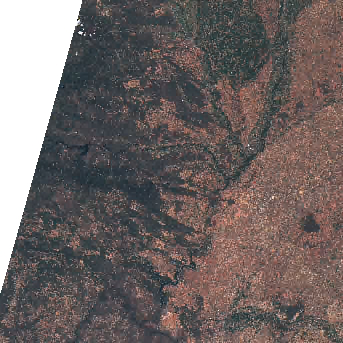

[[41.9278008844042, -5.313699115595799], [41.9367991155958, -5.3047008844042]]


width:  3
height: 3
[[41.407735551467, -6.598705291445], [42.429351627941, -5.2769788443522]]
[[41.9278008844042, -5.313699115595799], [41.9367991155958, -5.3047008844042]]
width:  75
height: 97
[[41.407735551467, -6.598705291445], [42.429351627941, -5.2769788443522]]
[[41.9278008844042, -5.313699115595799], [41.9367991155958, -5.3047008844042]]
width:  75
height: 97


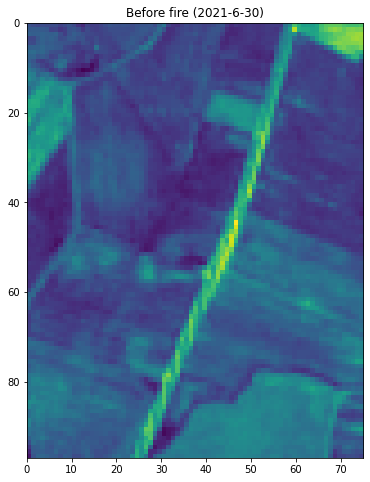

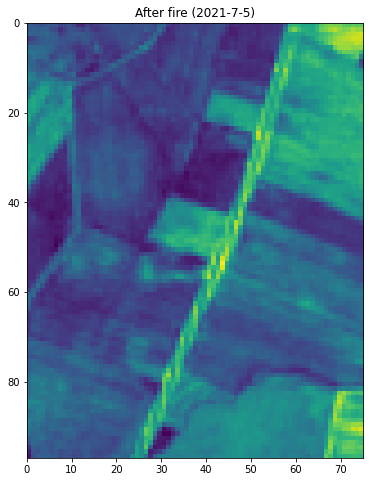

selected_row: latitude         41.9365
longitude        -5.2994
brightness         321.1
scan                 4.0
track                1.9
acq_date      2021-07-05
acq_time            1210
satellite          Terra
instrument         MODIS
confidence            76
version             6.03
bright_t31         300.3
frp                 84.4
daynight               D
type                   0
Name: 1786944, dtype: object
2021-07-05
search_bbox: -5.3038991155958,41.932000884404204,-5.294900884404201,41.9409991155958
9 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T30TTM_N03.01
  [[[[-6.3383913011071, 42.404043852148], [-6.3609973249227, 42.325356160405], [-6.598705291445, 41.57844229373], [-6.5892572504445, 41.407735551467], [-5.2769788443522, 41.441220929794], [-5.3124190586532, 42.429351627941], [-6.3383913011071, 42.404043852148]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210705T131926_A022614_T29TQG_N03.01
  [[[[-6.3324555021772, 42.421633042658], [-6.361098084949

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/30TTM,2021-06-30,0/
FOLDER_AFTER: ./AwsData/30TTM,2021-07-05,0/
fire_small_perimeter: [[41.932000884404204, -5.3038991155958], [41.9409991155958, -5.3038991155958], [41.9409991155958, -5.294900884404201], [41.932000884404204, -5.294900884404201], [41.932000884404204, -5.3038991155958]]


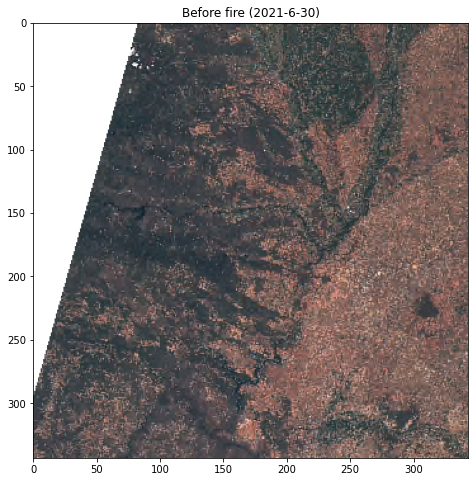

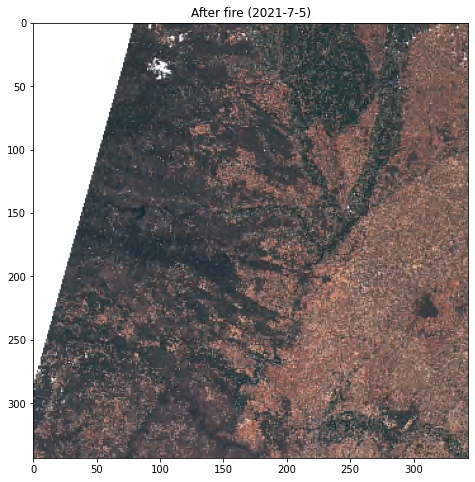

[[41.407735551467, -6.598705291445], [42.429351627941, -5.2769788443522]]


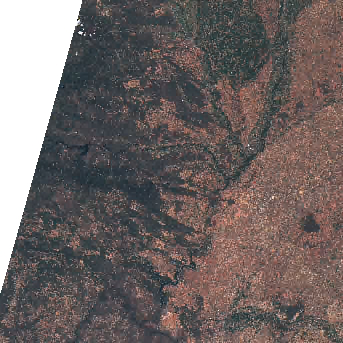

[[41.932000884404204, -5.3038991155958], [41.9409991155958, -5.294900884404201]]


width:  2
height: 3
[[41.407735551467, -6.598705291445], [42.429351627941, -5.2769788443522]]
[[41.932000884404204, -5.3038991155958], [41.9409991155958, -5.294900884404201]]
width:  75
height: 96
[[41.407735551467, -6.598705291445], [42.429351627941, -5.2769788443522]]
[[41.932000884404204, -5.3038991155958], [41.9409991155958, -5.294900884404201]]
width:  75
height: 96


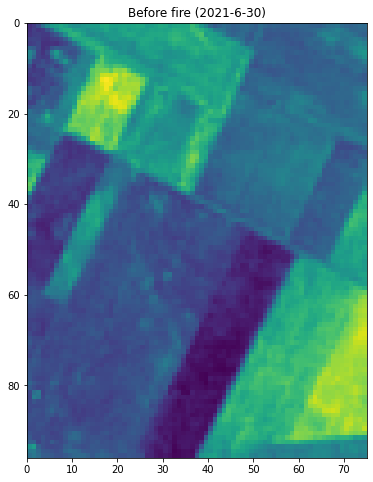

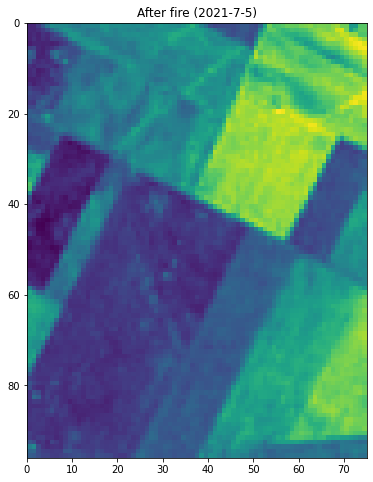

selected_row: latitude         41.6327
longitude         0.7737
brightness         308.1
scan                 1.3
track                1.1
acq_date      2021-07-05
acq_time            2138
satellite          Terra
instrument         MODIS
confidence            73
version             6.03
bright_t31         293.9
frp                 10.1
daynight               N
type                   0
Name: 1789486, dtype: object
2021-07-05
search_bbox: 0.7692008844042001,41.6282008844042,0.7781991155958,41.6371991155958
3 satellite moments in the interval:

S2B_OPER_MSI_L1C_TL_VGS4_20210709T132131_A022671_T31TCG_N03.01
  [[[[0.56881622416461, 42.426892946743], [0.60607246356987, 41.438845533419], [1.9199607187531, 41.458690506441], [1.9031363148662, 42.447433908733], [0.56881622416461, 42.426892946743]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210629T125658_A022528_T31TCG_N03.00
  [[[[0.56881622416461, 42.426892946743], [0.60607246356987, 41.438845533419], [1.9199607187531, 41.458690506441], [1.9031363148662, 42

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/31TCG,2021-06-24,0/


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_AFTER: ./AwsData/31TCG,2021-06-29,0/
fire_small_perimeter: [[41.6282008844042, 0.7692008844042001], [41.6371991155958, 0.7692008844042001], [41.6371991155958, 0.7781991155958], [41.6282008844042, 0.7781991155958], [41.6282008844042, 0.7692008844042001]]


/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


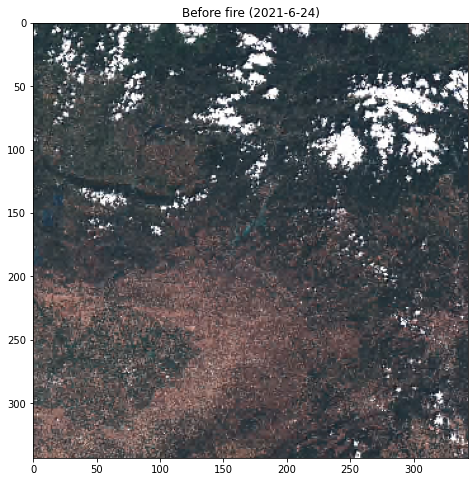

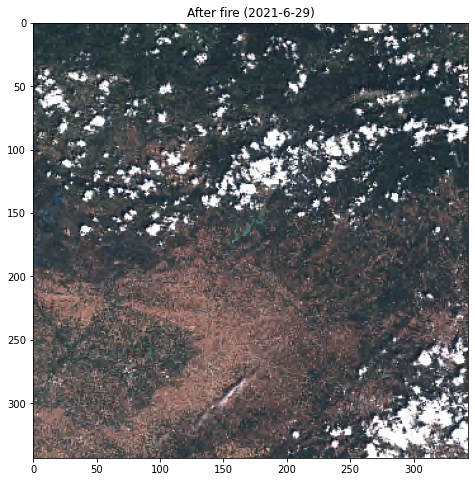

[[41.438845533419, 0.56881622416461], [42.447433908733, 1.9199607187531]]


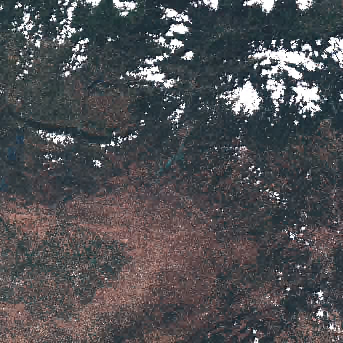

[[41.6282008844042, 0.7692008844042001], [41.6371991155958, 0.7781991155958]]


width:  2
height: 3
[[41.438845533419, 0.56881622416461], [42.447433908733, 1.9199607187531]]
[[41.6282008844042, 0.7692008844042001], [41.6371991155958, 0.7781991155958]]
width:  74
height: 98
[[41.438845533419, 0.56881622416461], [42.447433908733, 1.9199607187531]]
[[41.6282008844042, 0.7692008844042001], [41.6371991155958, 0.7781991155958]]
width:  74
height: 98


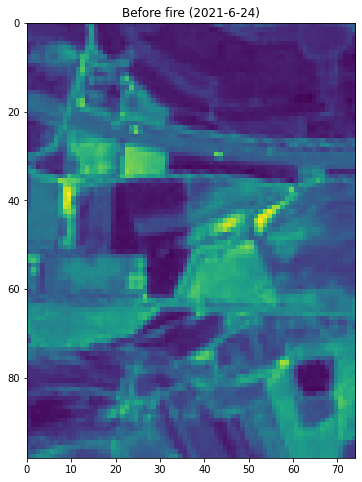

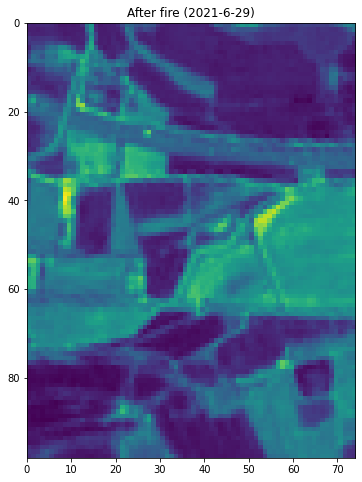

selected_row: latitude         36.5486
longitude         2.1075
brightness         332.7
scan                 2.4
track                1.5
acq_date      2021-07-06
acq_time            1117
satellite          Terra
instrument         MODIS
confidence            76
version             6.03
bright_t31         303.4
frp                 73.5
daynight               D
type                   0
Name: 1796127, dtype: object
2021-07-06
search_bbox: 2.1030008844042,36.5441008844042,2.1119991155958,36.5530991155958
6 satellite moments in the interval:

S2A_OPER_MSI_L1C_TL_VGS2_20210708T123744_A031565_T31SDA_N03.01
  [[[[2.1285333541226, 37.043373423328], [1.995091075703, 36.570191469075], [1.9543795443264, 36.417428359802], [1.88743904236, 36.185531110073], [1.8893272617186, 36.051587828664], [3.1083573665034, 36.056684010167], [3.1097480619864, 37.046523275889], [2.1285333541226, 37.043373423328]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210706T124446_A022628_T31SDA_N03.01
  [[[[1.8750761132301, 37.0412408773

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.00 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sentinelhub/aws.py:167: SHUserWarning: Products with baseline 03.01 are not officially supported in sentinelhub-py. If you notice any errors in naming structure of downloaded data please report an issue at https://github.com/sentinel-hub/sentinelhub-py/issues. Pull requests are also very appreciated
  warnings.warn(message, category=SHUserWarning)


FOLDER_BEFORE: ./AwsData/31SDA,2021-06-21,0/
FOLDER_AFTER: ./AwsData/31SDA,2021-07-08,0/
fire_small_perimeter: [[36.5441008844042, 2.1030008844042], [36.5530991155958, 2.1030008844042], [36.5530991155958, 2.1119991155958], [36.5441008844042, 2.1119991155958], [36.5441008844042, 2.1030008844042]]


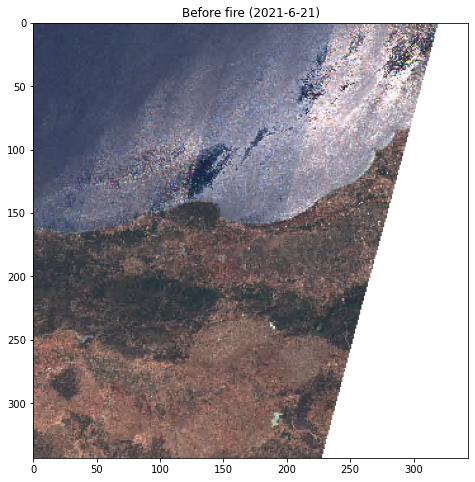

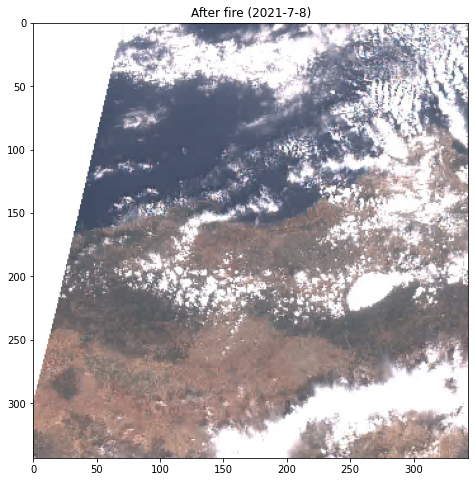

[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]


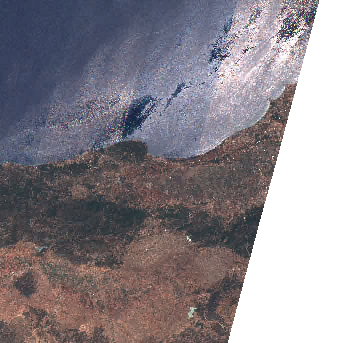

[[36.5441008844042, 2.1030008844042], [36.5530991155958, 2.1119991155958]]


width:  3
height: 3
[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]
[[36.5441008844042, 2.1030008844042], [36.5530991155958, 2.1119991155958]]
width:  81
height: 100
[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]
[[36.5441008844042, 2.1030008844042], [36.5530991155958, 2.1119991155958]]
width:  81
height: 100


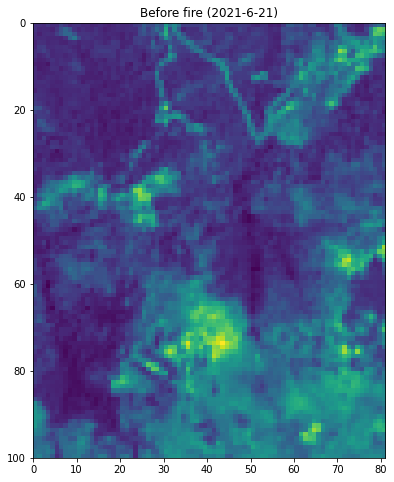

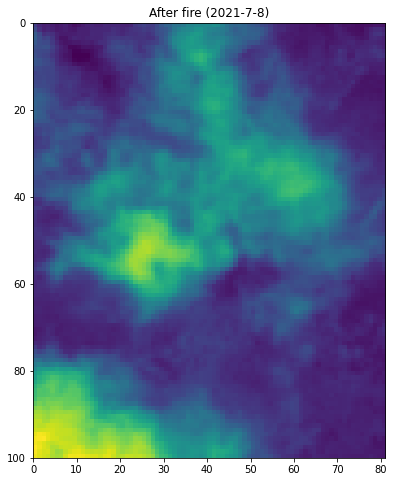

selected_row: latitude         36.4478
longitude         2.0798
brightness         366.1
scan                 1.0
track                1.0
acq_date      2021-07-06
acq_time            1257
satellite           Aqua
instrument         MODIS
confidence           100
version             6.03
bright_t31         312.7
frp                 91.3
daynight               D
type                   0
Name: 1802302, dtype: object
2021-07-06
search_bbox: 2.0753008844042,36.4433008844042,2.0842991155958,36.4522991155958
6 satellite moments in the interval:

S2A_OPER_MSI_L1C_TL_VGS2_20210708T123744_A031565_T31SDA_N03.01
  [[[[2.1285333541226, 37.043373423328], [1.995091075703, 36.570191469075], [1.9543795443264, 36.417428359802], [1.88743904236, 36.185531110073], [1.8893272617186, 36.051587828664], [3.1083573665034, 36.056684010167], [3.1097480619864, 37.046523275889], [2.1285333541226, 37.043373423328]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210706T124446_A022628_T31SDA_N03.01
  [[[[1.8750761132301, 37.0412408773

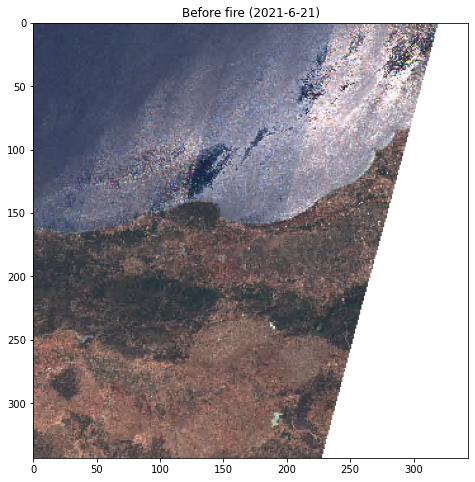

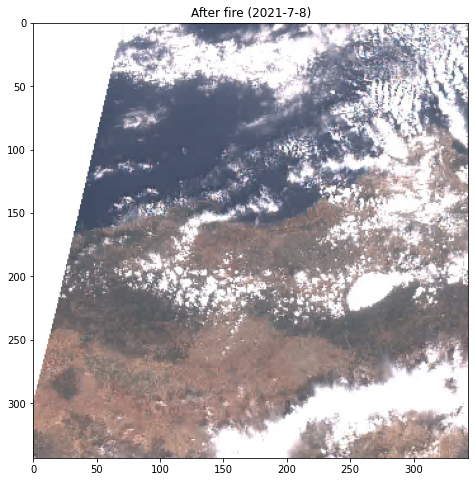

[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]


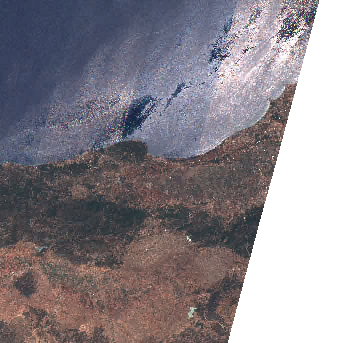

[[36.4433008844042, 2.0753008844042], [36.4522991155958, 2.0842991155958]]


width:  2
height: 3
[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]
[[36.4433008844042, 2.0753008844042], [36.4522991155958, 2.0842991155958]]
width:  80
height: 99
[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]
[[36.4433008844042, 2.0753008844042], [36.4522991155958, 2.0842991155958]]
width:  80
height: 99


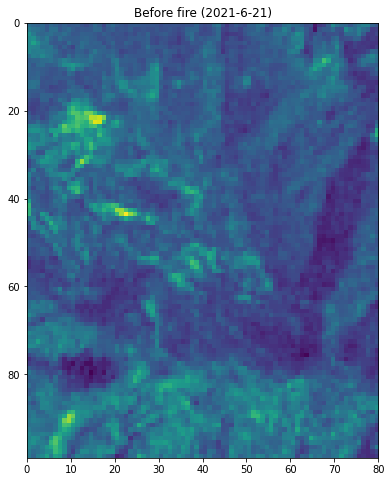

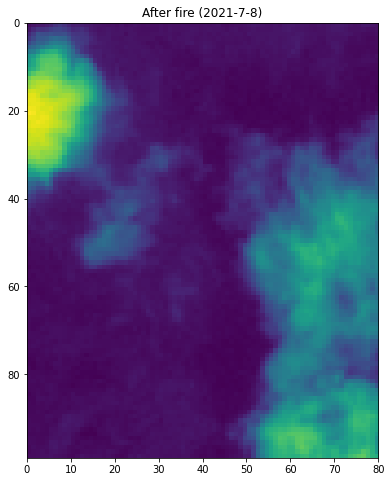

selected_row: latitude          36.455
longitude          2.066
brightness         332.8
scan                 1.0
track                1.0
acq_date      2021-07-06
acq_time            1257
satellite           Aqua
instrument         MODIS
confidence            71
version             6.03
bright_t31         310.4
frp                 15.9
daynight               D
type                   0
Name: 1802304, dtype: object
2021-07-06
search_bbox: 2.0615008844041998,36.4505008844042,2.0704991155958,36.4594991155958
6 satellite moments in the interval:

S2A_OPER_MSI_L1C_TL_VGS2_20210708T123744_A031565_T31SDA_N03.01
  [[[[2.1285333541226, 37.043373423328], [1.995091075703, 36.570191469075], [1.9543795443264, 36.417428359802], [1.88743904236, 36.185531110073], [1.8893272617186, 36.051587828664], [3.1083573665034, 36.056684010167], [3.1097480619864, 37.046523275889], [2.1285333541226, 37.043373423328]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210706T124446_A022628_T31SDA_N03.01
  [[[[1.8750761132301, 37.0412408

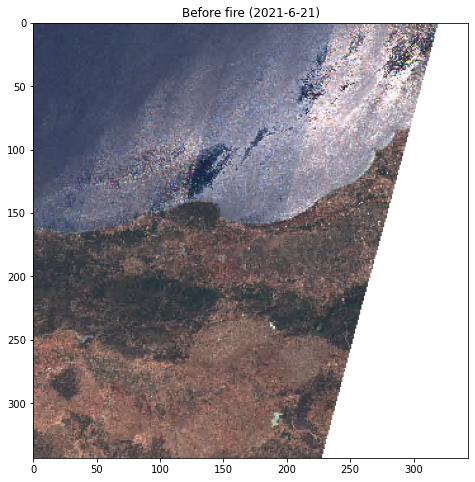

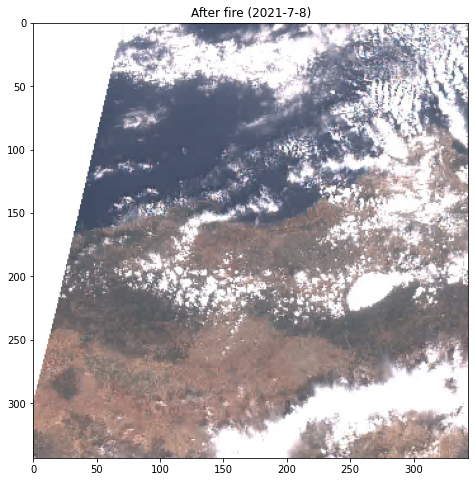

[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]


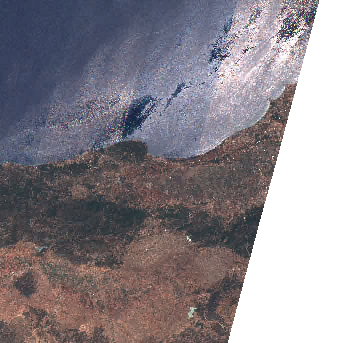

[[36.4505008844042, 2.0615008844041998], [36.4594991155958, 2.0704991155958]]


width:  2
height: 3
[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]
[[36.4505008844042, 2.0615008844041998], [36.4594991155958, 2.0704991155958]]
width:  80
height: 100
[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]
[[36.4505008844042, 2.0615008844041998], [36.4594991155958, 2.0704991155958]]
width:  80
height: 100


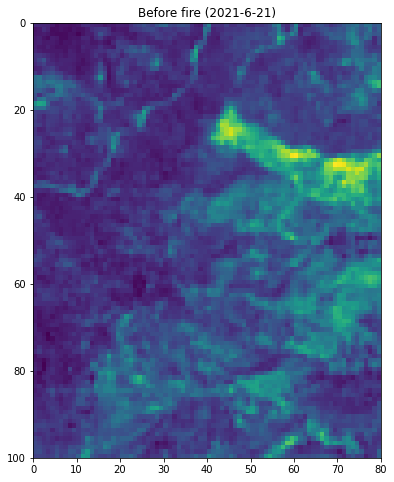

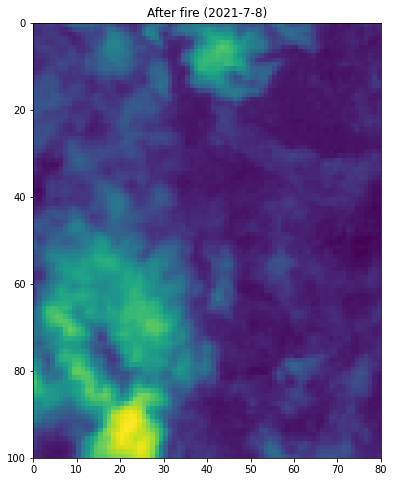

selected_row: latitude         36.4568
longitude         2.0774
brightness         368.1
scan                 1.0
track                1.0
acq_date      2021-07-06
acq_time            1257
satellite           Aqua
instrument         MODIS
confidence           100
version             6.03
bright_t31         312.2
frp                 97.4
daynight               D
type                   0
Name: 1802305, dtype: object
2021-07-06
search_bbox: 2.0729008844042,36.4523008844042,2.0818991155958,36.4612991155958
6 satellite moments in the interval:

S2A_OPER_MSI_L1C_TL_VGS2_20210708T123744_A031565_T31SDA_N03.01
  [[[[2.1285333541226, 37.043373423328], [1.995091075703, 36.570191469075], [1.9543795443264, 36.417428359802], [1.88743904236, 36.185531110073], [1.8893272617186, 36.051587828664], [3.1083573665034, 36.056684010167], [3.1097480619864, 37.046523275889], [2.1285333541226, 37.043373423328]]]]
S2B_OPER_MSI_L1C_TL_VGS2_20210706T124446_A022628_T31SDA_N03.01
  [[[[1.8750761132301, 37.0412408773

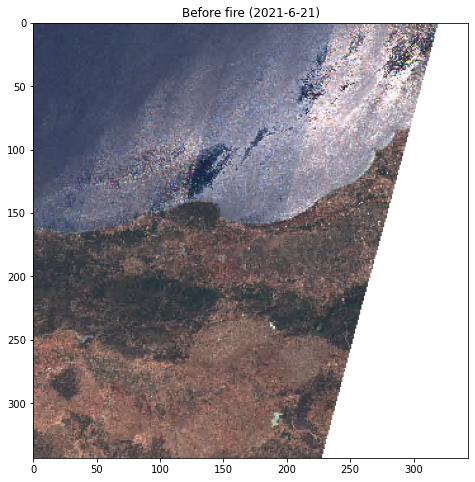

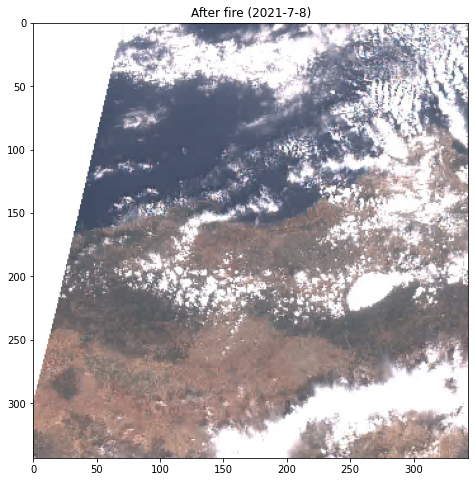

[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]


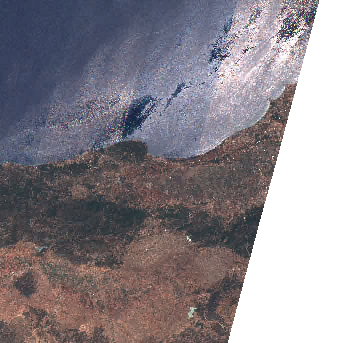

[[36.4523008844042, 2.0729008844042], [36.4612991155958, 2.0818991155958]]


width:  3
height: 3
[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]
[[36.4523008844042, 2.0729008844042], [36.4612991155958, 2.0818991155958]]
width:  81
height: 100
[[36.051587828664, 1.88743904236], [37.046523275889, 3.1097480619864]]
[[36.4523008844042, 2.0729008844042], [36.4612991155958, 2.0818991155958]]


FileNotFoundError: [Errno 2] No such file or directory: './AwsData/31SDA,2021-07-08,0/B02.jp2.crop.png'

In [831]:
THE_BAND = 'B02'

for index, row in df_for_dataset.iterrows():
# for i in [1721288]: # , 1702958, 1721288, 1724841, 1987646]:
    row_selected = row # df_orig.iloc[i]
    print('selected_row: ' + str(row_selected))
    
    search_time_interval, lat_lon = get_search_time_interval_and_lat_lon(row_selected)

    search_bbox = get_search_bbox(lat_lon)
    print('search_bbox: ' + str(search_bbox))
    
    tile_id_before_fire, tile_id_after_fire, bound_tile = get_data_before_and_after_one_fire(search_bbox, search_time_interval)
    print(tile_id_before_fire)
    print(tile_id_after_fire)
    print('bound_tile: ' + str(bound_tile))
    
    tile_name_before, time_before, aws_index_before = AwsTile.tile_id_to_tile(tile_id_before_fire)
    tile_name_after, time_after, aws_index_after = AwsTile.tile_id_to_tile(tile_id_after_fire)
    
    FOLDER_BEFORE, FOLDER_AFTER = request_tiles(tile_name_before, time_before, aws_index_before, tile_name_after, time_after, aws_index_after)
    
    fire_small_perimeter = swap_lat_lon(search_bbox.get_polygon())
    print('fire_small_perimeter: ' + str(fire_small_perimeter))
    
    bound_tile = swap_lat_lon(bound_tile)
    
    show_image_before_and_after(FOLDER_BEFORE, FOLDER_AFTER, time_before, time_after, 'preview.jpg')
    
    crop_image_geo(FOLDER_BEFORE + 'preview.jpg', DATASET_CROPPED_BEFORE_FIRE_FOLDER + FOLDER_BEFORE.split('/')[-2] + '.preview.jpg', bound_tile[:-1], fire_small_perimeter[:-1], True, True)
    
    crop_image_geo(FOLDER_BEFORE + THE_BAND + '.jp2', DATASET_CROPPED_BEFORE_FIRE_FOLDER + FOLDER_BEFORE.split('/')[-2] + '.' + THE_BAND + '.jp2', bound_tile[:-1], fire_small_perimeter[:-1], False, False)
    crop_image_geo(FOLDER_AFTER + THE_BAND + '.jp2', FOLDER_AFTER + THE_BAND + '.jp2', bound_tile[:-1], fire_small_perimeter[:-1], False, False)
    
    show_image_before_and_after(DATASET_CROPPED_BEFORE_FIRE_FOLDER + FOLDER_BEFORE.split('/')[-2] + '.', FOLDER_AFTER, time_before, time_after, THE_BAND + '.jp2.crop.png')

In [834]:
print('Done :)')

Done :)


In [833]:
!tar -czf dataset_before_fire.tar.gz dataset_before_fire

### 10. Off Topic: Normalized Difference Vegetation Index - NVDI

In [341]:
def show_ndvi(folder, title):
    b4 = rasterio.open(folder + 'B04.jp2')
    b8 = rasterio.open(folder + 'B08.jp2')

    # read Red(b4) and NIR(b8) as arrays
    red = b4.read()
    nir = b8.read()
    ndvi = (nir.astype(float)-red.astype(float))/(nir.astype(float)+red.astype(float))

    title_full = title + ". Normalized Difference Vegetation Index (NDVI)"
    ep.plot_bands(ndvi, cmap="RdYlGn", cols=1, title=title_full, vmin=-1, vmax=1);
    

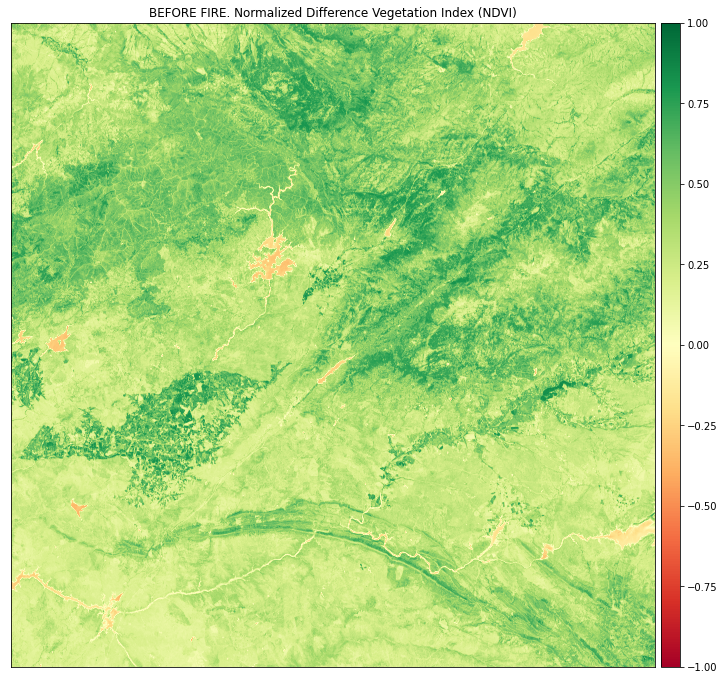

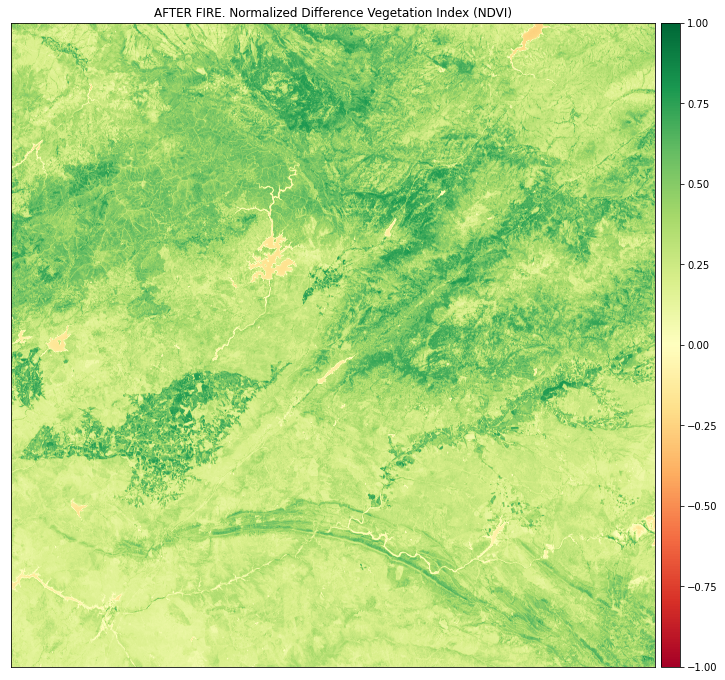

In [340]:
show_ndvi(FOLDER_BEFORE, 'BEFORE FIRE')
show_ndvi(FOLDER_AFTER, 'AFTER FIRE')

### 11. Convert from mono Band to RGB.

In [97]:
def convert_from_one_band_to_gray(pathfile):
    new_file_aux = 'temp.tiff'

    band2=rasterio.open(pathfile)

    band2_geo = band2.profile
    band2_geo.update({"count": 3})

    with rasterio.open(new_file_aux, 'w', **band2_geo) as dest:
        dest.write(band2.read(1),1)
        dest.write(band2.read(1),2)
        dest.write(band2.read(1),3)

    rgb_image = rasterio.open(new_file_aux)

    max_pixel_value = rgb_image.read().max()
    rgb_image = np.multiply(rgb_image.read(), 255.0)
    rgb_image = np.divide(rgb_image, max_pixel_value)
    rgb_image = rgb_image.astype(np.uint8)
    
    rgb_image.astype(np.uint8)

    # print('rgb_image shape: ' + str(rgb_image.shape))
    # print(str(rgb_image))
    # plot.show(rgb_image)
    
    im = Image.fromarray(rgb_image[0])
    
    return im

In [105]:
if not os.path.exists('dataset_before_fire_gray'):
    os.makedirs('dataset_before_fire_gray')

In [98]:
train_fire_list_png = glob.glob(os.path.join('./dataset_before_fire','*.jp2.crop.png'))
train_fire_list_png

['./dataset_before_fire/29TNG,2021-07-13,0.B02.jp2.crop.png',
 './dataset_before_fire/30SVJ,2021-06-17,0.B02.jp2.crop.png',
 './dataset_before_fire/31SCV,2021-06-16,1.B02.jp2.crop.png',
 './dataset_before_fire/30SXE,2021-06-24,0.B02.jp2.crop.png',
 './dataset_before_fire/29SNB,2021-06-23,0.B02.jp2.crop.png',
 './dataset_before_fire/30SXJ,2021-06-24,0.B02.jp2.crop.png',
 './dataset_before_fire/30TVK,2021-06-27,0.B02.jp2.crop.png',
 './dataset_before_fire/29SQC,2021-06-30,0.B02.jp2.crop.png',
 './dataset_before_fire/31TEH,2021-06-21,0.B02.jp2.crop.png',
 './dataset_before_fire/30SUH,2021-06-27,0.B02.jp2.crop.png',
 './dataset_before_fire/29SPD,2021-06-23,0.B02.jp2.crop.png',
 './dataset_before_fire/31SDA,2021-06-21,0.B02.jp2.crop.png',
 './dataset_before_fire/30TTM,2021-06-30,0.B02.jp2.crop.png',
 './dataset_before_fire/31TCG,2021-06-24,0.B02.jp2.crop.png']

In [99]:
# x = convert_from_one_band_to_gray('./dataset_before_fire/29TNG,2021-07-13,0.B02.jp2.crop.png')
# x.save('borrar.png')

In [100]:
for one in train_fire_list_png:
    im = convert_from_one_band_to_gray(one)
    im.save('./dataset_before_fire_gray/' + one.split('/')[-1])
print('Converted :)')

Converted :)


### 12. Visual Transformer. Classification between potential place for future fire and no future fire.

In [1]:
%pip -q install vit_pytorch linformer

Note: you may need to restart the kernel to use updated packages.


In [2]:
%pip install sklearn

Note: you may need to restart the kernel to use updated packages.


In [17]:
from __future__ import print_function

from itertools import chain
import os
import random
import zipfile

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from linformer import Linformer
from PIL import Image
from sklearn.model_selection import train_test_split
from torch.optim.lr_scheduler import StepLR
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms
from tqdm.notebook import tqdm

from vit_pytorch.efficient import ViT

In [18]:
print(f"Torch: {torch.__version__}")

Torch: 1.10.2+cu102


In [19]:
# Training settings
batch_size = 64
epochs = 20
lr = 3e-5
gamma = 0.7
seed = 42

In [20]:
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True

seed_everything(seed)

In [21]:
device = 'cuda'

In [22]:
%pwd

'/home/studio-lab-user'

In [23]:
train_fire_list_png_gray = glob.glob(os.path.join('./dataset_before_fire_gray/','*.jp2.crop.png'))
train_fire_list_png_gray

['./dataset_before_fire_gray/fire.29TNG,2021-07-13,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.30SVJ,2021-06-17,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.31SCV,2021-06-16,1.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.30SXE,2021-06-24,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.29SNB,2021-06-23,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.30SXJ,2021-06-24,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.30TVK,2021-06-27,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.29SQC,2021-06-30,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.31TEH,2021-06-21,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.30SUH,2021-06-27,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.29SPD,2021-06-23,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.31SDA,2021-06-21,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.30TTM,2021-06-30,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.31TCG,2021-06-24,0.B02.jp2.cro

In [24]:
for one in train_fire_list_png_gray:
    os.rename(one, './dataset_before_fire_gray/' + 'fire.' + os.path.basename(one))

In [25]:
train_fire_list_png_gray = glob.glob(os.path.join('./dataset_before_fire_gray/','*.jp2.crop.png'))
train_fire_list_png_gray

['./dataset_before_fire_gray/fire.fire.29SQC,2021-06-30,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.31TEH,2021-06-21,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.30SUH,2021-06-27,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.29SPD,2021-06-23,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.31SDA,2021-06-21,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.31TCG,2021-06-24,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.29TNG,2021-07-13,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.30SVJ,2021-06-17,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.31SCV,2021-06-16,1.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.30SXE,2021-06-24,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.29SNB,2021-06-23,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.30SXJ,2021-06-24,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.30TVK,2021-06-27,0.B02.jp2.crop.png',

In [26]:
train_no_fire = glob.glob(os.path.join('./dataset_no_fire','*.jpg'))
train_no_fire

['./dataset_no_fire/no.10872.jpg',
 './dataset_no_fire/no.10869.jpg',
 './dataset_no_fire/no.10875.jpg',
 './dataset_no_fire/no.10882.jpg',
 './dataset_no_fire/no.10886.jpg',
 './dataset_no_fire/no.10893.jpg',
 './dataset_no_fire/no.10903.jpg',
 './dataset_no_fire/no.10894.jpg',
 './dataset_no_fire/no.109.jpg',
 './dataset_no_fire/no.10898.jpg',
 './dataset_no_fire/no.10896.jpg']

In [101]:
if not os.path.exists('dataset_no_fire_gray'):
    os.makedirs('dataset_no_fire_gray')
    
for one in train_no_fire:
    x = convert_from_one_band_to_gray(one)
    x.save('./dataset_no_fire_gray/' + os.path.basename(one))

In [102]:
train_no_fire_gray = glob.glob(os.path.join('./dataset_no_fire_gray','*.jpg'))
train_no_fire_gray

['./dataset_no_fire_gray/no.10872.jpg',
 './dataset_no_fire_gray/no.10869.jpg',
 './dataset_no_fire_gray/no.10875.jpg',
 './dataset_no_fire_gray/no.10882.jpg',
 './dataset_no_fire_gray/no.10886.jpg',
 './dataset_no_fire_gray/no.10893.jpg',
 './dataset_no_fire_gray/no.10903.jpg',
 './dataset_no_fire_gray/no.10894.jpg',
 './dataset_no_fire_gray/no.109.jpg',
 './dataset_no_fire_gray/no.10898.jpg',
 './dataset_no_fire_gray/no.10896.jpg']

In [103]:
train_list = train_no_fire_gray + train_fire_list_png_gray
train_list

['./dataset_no_fire_gray/no.10872.jpg',
 './dataset_no_fire_gray/no.10869.jpg',
 './dataset_no_fire_gray/no.10875.jpg',
 './dataset_no_fire_gray/no.10882.jpg',
 './dataset_no_fire_gray/no.10886.jpg',
 './dataset_no_fire_gray/no.10893.jpg',
 './dataset_no_fire_gray/no.10903.jpg',
 './dataset_no_fire_gray/no.10894.jpg',
 './dataset_no_fire_gray/no.109.jpg',
 './dataset_no_fire_gray/no.10898.jpg',
 './dataset_no_fire_gray/no.10896.jpg',
 './dataset_before_fire_gray/fire.fire.29SQC,2021-06-30,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.31TEH,2021-06-21,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.30SUH,2021-06-27,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.29SPD,2021-06-23,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.31SDA,2021-06-21,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.31TCG,2021-06-24,0.B02.jp2.crop.png',
 './dataset_before_fire_gray/fire.fire.29TNG,2021-07-13,0.B02.jp2.crop.png',
 './dataset_before_fire

In [104]:
random.shuffle(train_list)

In [105]:
labels = [path.split('/')[-1].split('.')[0] for path in train_list]
labels

['no',
 'fire',
 'fire',
 'no',
 'fire',
 'no',
 'no',
 'fire',
 'fire',
 'fire',
 'fire',
 'fire',
 'fire',
 'fire',
 'no',
 'fire',
 'no',
 'no',
 'fire',
 'no',
 'fire',
 'no',
 'no',
 'no',
 'fire']

In [106]:
len(train_list)

25

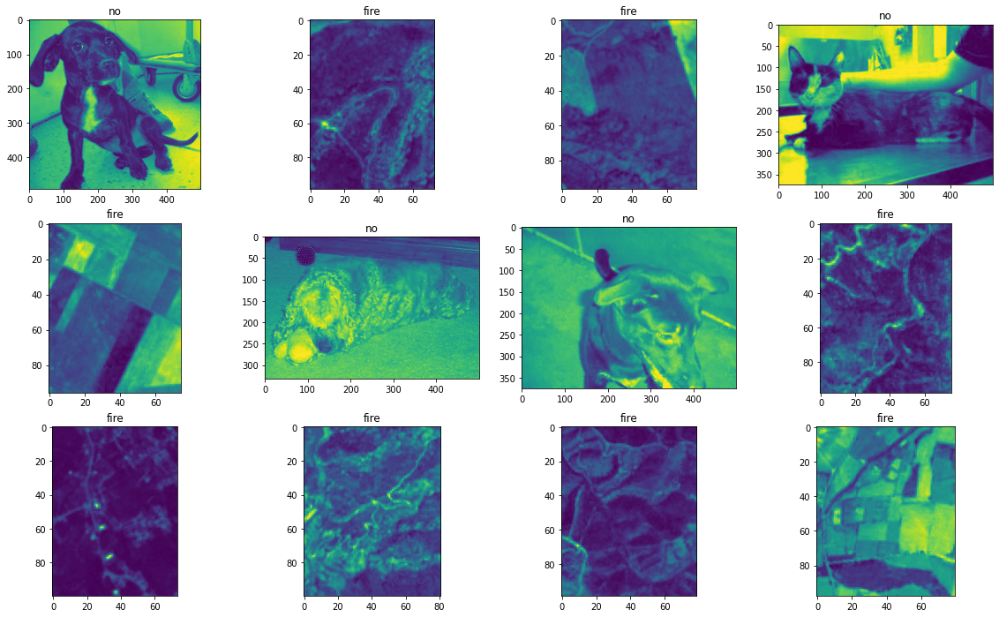

In [107]:
random_idx = np.random.randint(1, len(train_list))
fig, axes = plt.subplots(3, 4, figsize=(20, 12))

for idx, ax in enumerate(axes.ravel()):
    img = Image.open(train_list[idx])
    ax.set_title(labels[idx])
    ax.imshow(img)

In [108]:
train_list, valid_list = train_test_split(train_list, 
                                          test_size=0.2,
                                          stratify=labels,
                                          random_state=seed)

In [109]:
print(f"Train Data: {len(train_list)}")
print(f"Validation Data: {len(valid_list)}")
# print(f"Test Data: {len(test_list)}")

Train Data: 20
Validation Data: 5


In [110]:
# image augmentation:
train_transforms = transforms.Compose(
    [
        transforms.Resize((224, 224)),
        transforms.RandomResizedCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
    ]
)

val_transforms = transforms.Compose(
    [
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
    ]
)


test_transforms = transforms.Compose(
    [
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
    ]
)


In [111]:
# load dataset:
class CatsDogsDataset(Dataset):
    def __init__(self, file_list, transform=None):
        self.file_list = file_list
        self.transform = transform

    def __len__(self):
        self.filelength = len(self.file_list)
        return self.filelength

    def __getitem__(self, idx):
        img_path = self.file_list[idx]
        img = Image.open(img_path)
        img_transformed = self.transform(img)

        label = img_path.split("/")[-1].split(".")[0]
        label = 1 if label == "fire" else 0

        return img_transformed, label


In [112]:
train_data = CatsDogsDataset(train_list, transform=train_transforms)
valid_data = CatsDogsDataset(valid_list, transform=test_transforms)
# test_data = CatsDogsDataset(test_list, transform=test_transforms)

In [113]:
train_loader = DataLoader(dataset = train_data, batch_size=batch_size, shuffle=True )
valid_loader = DataLoader(dataset = valid_data, batch_size=batch_size, shuffle=True)
# test_loader = DataLoader(dataset = test_data, batch_size=batch_size, shuffle=True)

In [114]:
print(len(train_data), len(train_loader))

20 1


In [115]:
print(len(valid_data), len(valid_loader))

5 1


In [116]:
efficient_transformer = Linformer(
    dim=128,
    seq_len=49+1,  # 7x7 patches + 1 cls-token
    depth=12,
    heads=8,
    k=64
)

In [117]:
model = ViT(
    dim=128,
    image_size=224,
    patch_size=32,
    num_classes=2,
    transformer=efficient_transformer,
    channels=3,
).to(device)

In [118]:
# loss function
criterion = nn.CrossEntropyLoss()
# optimizer
optimizer = optim.Adam(model.parameters(), lr=lr)
# scheduler
scheduler = StepLR(optimizer, step_size=1, gamma=gamma)

In [119]:
for epoch in range(epochs):
    epoch_loss = 0
    epoch_accuracy = 0

    for data, label in tqdm(train_loader):
        data = data.to(device)
        label = label.to(device)

        output = model(data)
        loss = criterion(output, label)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        acc = (output.argmax(dim=1) == label).float().mean()
        epoch_accuracy += acc / len(train_loader)
        epoch_loss += loss / len(train_loader)

    with torch.no_grad():
        epoch_val_accuracy = 0
        epoch_val_loss = 0
        for data, label in valid_loader:
            data = data.to(device)
            label = label.to(device)

            val_output = model(data)
            val_loss = criterion(val_output, label)

            acc = (val_output.argmax(dim=1) == label).float().mean()
            epoch_val_accuracy += acc / len(valid_loader)
            epoch_val_loss += val_loss / len(valid_loader)

    print(
        f"Epoch : {epoch+1} - loss : {epoch_loss:.4f} - acc: {epoch_accuracy:.4f} - val_loss : {epoch_val_loss:.4f} - val_acc: {epoch_val_accuracy:.4f}\n"
    )


  0%|          | 0/1 [00:00<?, ?it/s]

RuntimeError: mat1 and mat2 shapes cannot be multiplied (980x1024 and 3072x128)

In [31]:
model.eval()

ViT(
  (to_patch_embedding): Sequential(
    (0): Rearrange('b c (h p1) (w p2) -> b (h w) (p1 p2 c)', p1=32, p2=32)
    (1): Linear(in_features=3072, out_features=128, bias=True)
  )
  (transformer): Linformer(
    (net): SequentialSequence(
      (layers): ModuleList(
        (0): ModuleList(
          (0): PreNorm(
            (fn): LinformerSelfAttention(
              (to_q): Linear(in_features=128, out_features=128, bias=False)
              (to_k): Linear(in_features=128, out_features=128, bias=False)
              (to_v): Linear(in_features=128, out_features=128, bias=False)
              (dropout): Dropout(p=0.0, inplace=False)
              (to_out): Linear(in_features=128, out_features=128, bias=True)
            )
            (norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
          )
          (1): PreNorm(
            (fn): FeedForward(
              (w1): Linear(in_features=128, out_features=512, bias=True)
              (act): GELU()
              (dropout)

### Tests

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


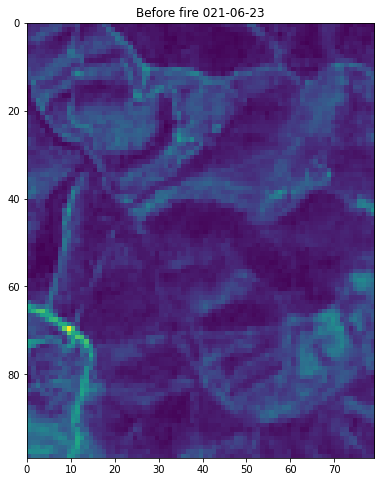

<AxesSubplot:title={'center':'Before fire 021-06-23'}>

In [35]:
src = rasterio.open('./dataset_before_fire/29SNB,2021-06-23,0.B02.jp2.crop.png')
plt.figure(figsize=(8,8))
plt.title('Before fire 021-06-23')
plot.show(src)